# **FitGPT** 

In [1]:
pip install catboost

Note: you may need to restart the kernel to use updated packages.


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split, GridSearchCV, KFold, RandomizedSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, RocCurveDisplay

from joblib import dump, load
from catboost import CatBoostClassifier

In [3]:
%matplotlib inline

In [4]:
sns.set_style("darkgrid")

Let's begin by loading the dataset:

In [5]:
data = pd.read_csv("calories_burned_fitgpt_gym.csv")
data

,Age,Gender,Weight (kg),Height (m),Max_BPM,Avg_BPM,Resting_BPM,Session_Duration (hours),Calories_Burned,Workout_Type,Fat_Percentage,Water_Intake (liters),Workout_Frequency (days/week),Experience_Level,BMI
0,56,Male,88.3,1.71,180,157,60,1.69,1313.0,Yoga,12.6,3.5,4,3,30.20
1,46,Female,74.9,1.53,179,151,66,1.30,883.0,HIIT,33.9,2.1,4,2,32.00
2,32,Female,68.1,1.66,167,122,54,1.11,677.0,Cardio,33.4,2.3,4,2,24.71
3,25,Male,53.2,1.70,190,164,56,0.59,532.0,Strength,28.8,2.1,3,1,18.41
4,38,Male,46.1,1.79,188,158,68,0.64,556.0,Strength,29.2,2.8,3,1,14.39
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
968,24,Male,87.1,1.74,187,158,67,1.57,1364.0,Strength,10.0,3.5,4,3,28.77
969,25,Male,66.6,1.61,184,166,56,1.38,1260.0,Strength,25.0,3.0,2,1,25.69
970,59,Female,60.4,1.76,194,120,53,1.72,929.0,Cardio,18.8,2.7,5,3,19.50
971,32,Male,126.4,1.83,198,146,62,1.10,883.0,HIIT,28.2,2.1,3,2,37.74


## **1. Data Cleaning, Preparation and EDA**

The first step we are going to perform in the cleaning is checking the data types:

In [6]:
data.dtypes

Age                                int64
Gender                            object
Weight (kg)                      float64
Height (m)                       float64
Max_BPM                            int64
Avg_BPM                            int64
Resting_BPM                        int64
Session_Duration (hours)         float64
Calories_Burned                  float64
Workout_Type                      object
Fat_Percentage                   float64
Water_Intake (liters)            float64
Workout_Frequency (days/week)      int64
Experience_Level                   int64
BMI                              float64
dtype: object

They all look correct, which is nice. By taking a look at the "Calories_Burned" category, it looks like it only contains numbers. We won't convert that to "int", though, because that would be our target variable and it would be better to keep it "float".

The feature names are not written in a pythonic way so we might as well convert them:

In [7]:
def make_pythonic(str):
    return str.lower().replace(" ", "_").replace("(", "").replace(")", "").replace("/", "_per_")

In [8]:
data.columns = [make_pythonic(col) for col in data.columns]

In [9]:
data.columns

Index(['age', 'gender', 'weight_kg', 'height_m', 'max_bpm', 'avg_bpm',
       'resting_bpm', 'session_duration_hours', 'calories_burned',
       'workout_type', 'fat_percentage', 'water_intake_liters',
       'workout_frequency_days_per_week', 'experience_level', 'bmi'],
      dtype='object')

That's much better!

Now we are going to see if there are any missing values:

In [10]:
data.isna().mean().sort_values(ascending=False)

age                                0.0
gender                             0.0
weight_kg                          0.0
height_m                           0.0
max_bpm                            0.0
avg_bpm                            0.0
resting_bpm                        0.0
session_duration_hours             0.0
calories_burned                    0.0
workout_type                       0.0
fat_percentage                     0.0
water_intake_liters                0.0
workout_frequency_days_per_week    0.0
experience_level                   0.0
bmi                                0.0
dtype: float64

Surprisingly, there are no missing values, which is great!

Now that we know the data is properly formatted, it's time to do some feature exploration. Let's begin with the age distribution:

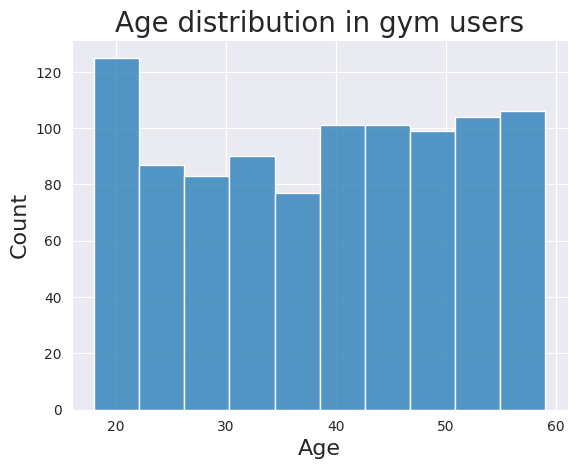

In [11]:
sns.histplot(data=data["age"], bins="fd")

plt.title("Age distribution in gym users", fontsize=20)
plt.xlabel("Age", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

Contrary to what I was expecting, the age groups resemble prettly closely a uniform distribution, although there is a noticeable peak in the smallest age group.

Now let's create a feature for the age groups in order to continue our feature exploration:

In [12]:
age_groups = ["18-22", "23-28", "29-33", "34-39", "40-44", "45-49", "50-54", "55-59"]

In [13]:
for group in age_groups:
    data.loc[(data["age"] >= int(group[:2])) & (data["age"] <= int(group[-2:])), "age_group"] = group

Let's check the distribution one more time, now that we have set age groups:

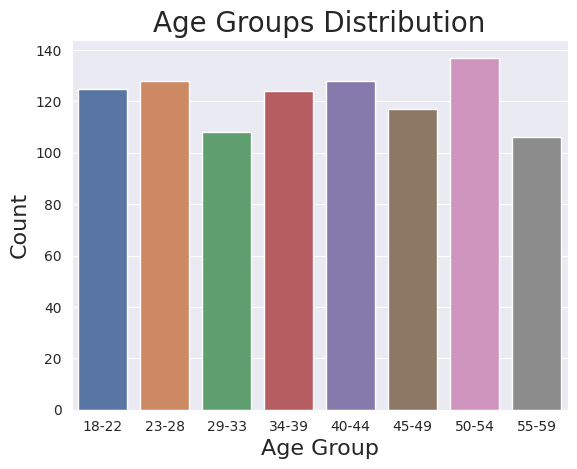

In [14]:
sns.countplot(data.sort_values("age_group"), x="age_group", hue="age_group", palette="deep")

plt.title("Age Groups Distribution", fontsize=20)
plt.xlabel("Age Group", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

Now it's time to explore the other features. Let's plot the gender:

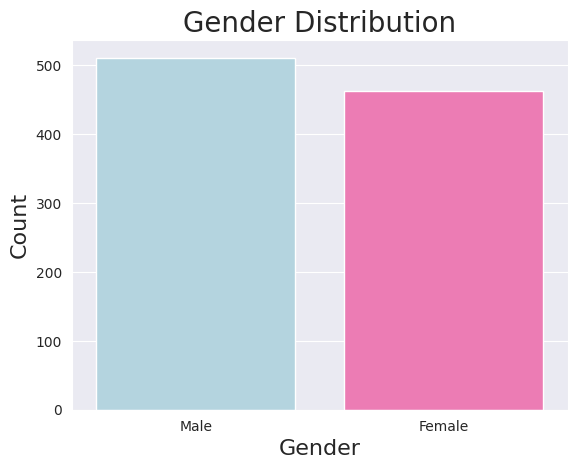

In [15]:
sns.countplot(data, x="gender", hue="gender", palette=["lightblue", "hotpink"])

plt.title("Gender Distribution", fontsize=20)
plt.xlabel("Gender", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

Here we see again, that the values are pretty equal. Now let's see if there is any  difference with each age group:

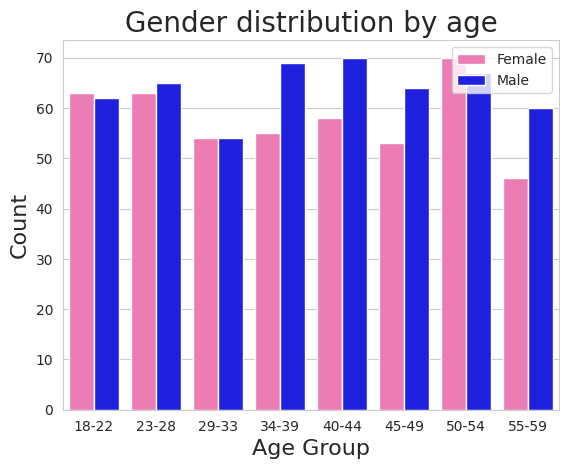

In [16]:
sns.set_style("whitegrid")

sns.countplot(data.sort_values("age_group"), x="age_group", hue="gender", palette=["hotpink", "blue"])

plt.legend(loc="upper right")
plt.title("Gender distribution by age", fontsize=20)
plt.xlabel("Age Group", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

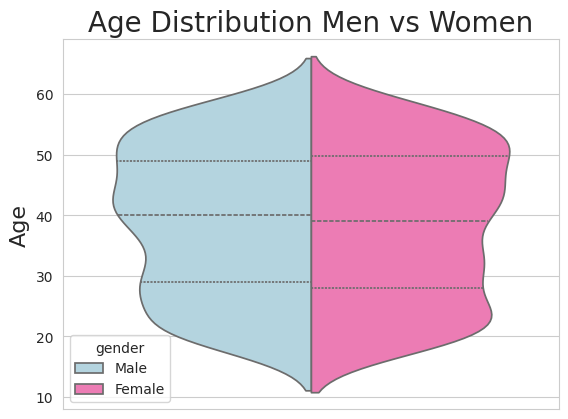

In [17]:
sns.violinplot(data, y="age", hue="gender", palette=["lightblue", "hotpink"], inner="quart", split=True)

plt.title("Age Distribution Men vs Women", fontsize=20)
plt.ylabel("Age", fontsize=16)

plt.show()

We can see, that there tend to be a little bit more men in the older group, but aside from that, they are pretty evenly distributed.

Now let's explore the weights

In [18]:
data["weight_kg"].describe()

count    973.000000
mean      73.854676
std       21.207500
min       40.000000
25%       58.100000
50%       70.000000
75%       86.000000
max      129.900000
Name: weight_kg, dtype: float64

No surprises here, let's draw some plots to see it clearer:

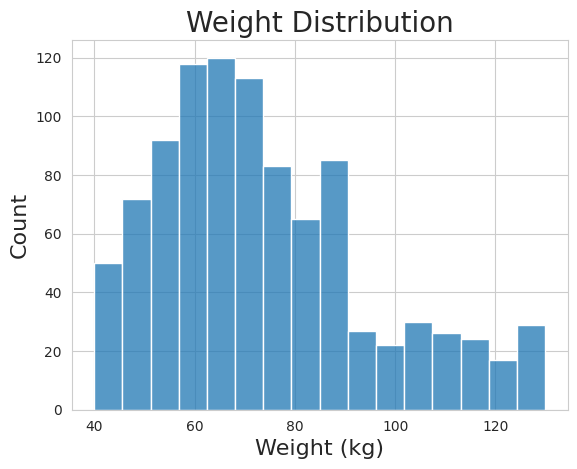

In [19]:
sns.histplot(data, x="weight_kg", bins="fd")

plt.title("Weight Distribution", fontsize=20)
plt.xlabel("Weight (kg)", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

Like expected, there is sort of a right tail with overweight people. But we know, that there is a big difference between the male and female weights. Let's look into it:

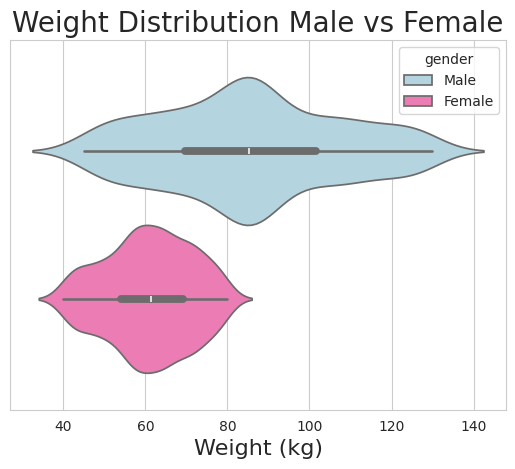

In [20]:
sns.violinplot(data, x="weight_kg", hue="gender", palette=["lightblue", "hotpink"])

plt.title("Weight Distribution Male vs Female", fontsize=20)
plt.xlabel("Weight (kg)", fontsize=16)

plt.show()

There is a bigger difference than I expected. More interestingly, the heaviest female is lighter than the center of the male mode in this distribution. Let's see exact values:

In [21]:
data[data["gender"] == "Female"]["weight_kg"].describe()

count    462.000000
mean      60.939827
std       10.237671
min       40.000000
25%       54.050000
50%       61.350000
75%       69.175000
max       79.900000
Name: weight_kg, dtype: float64

In [22]:
data[data["gender"] == "Male"]["weight_kg"].describe()

count    511.000000
mean      85.531115
std       21.788629
min       45.000000
25%       69.750000
50%       85.300000
75%      101.600000
max      129.900000
Name: weight_kg, dtype: float64

Here we can see, that the heaviest female is lighter than the average male, according to the mean of the male weight. That's interesting.

Now let's do the same exploration for the height:

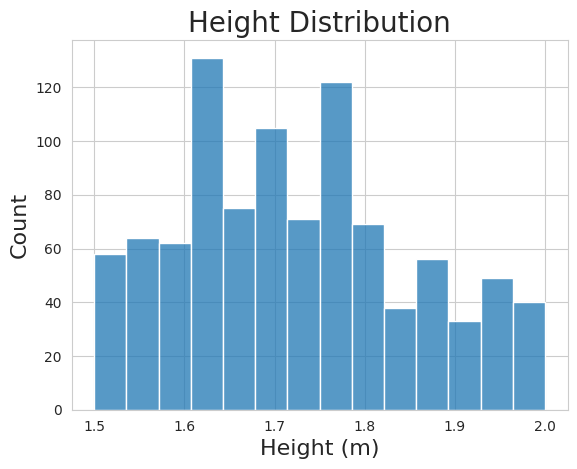

In [23]:
sns.histplot(data, x="height_m", bins="fd")

plt.title("Height Distribution", fontsize=20)
plt.xlabel("Height (m)", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

We see a clear bimodal distribution, which is again a sign, that there would be gender differences. Let's see if this is correct:

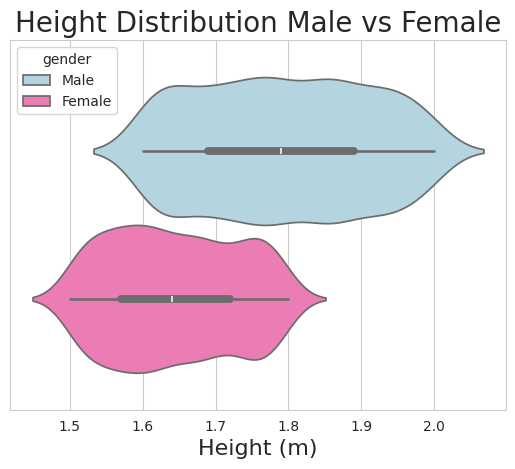

In [24]:
sns.violinplot(data, x="height_m", hue="gender", palette = ["lightblue", "hotpink"])

plt.title("Height Distribution Male vs Female", fontsize=20)
plt.xlabel("Height (m)", fontsize=16)

plt.show()

No surprises here, women tend to be shorter than men.

Let's get into the BPM features. We are going to explore them at once for gender and age group, because they are connected.

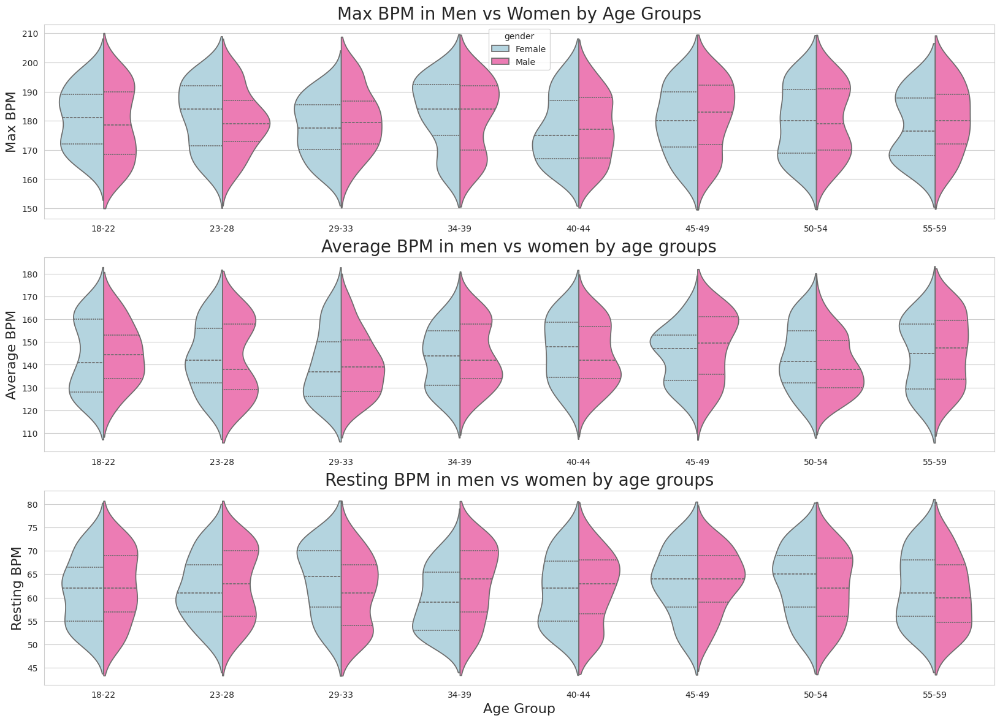

In [25]:
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(20, 14))

sns.violinplot(data.sort_values("age_group"), x="age_group", y="max_bpm", hue="gender", palette=["lightblue", "hotpink"], split=True, inner="quart", ax=axes[0])
sns.violinplot(data.sort_values("age_group"), x="age_group", y="avg_bpm", hue="gender", palette=["lightblue", "hotpink"], split=True, inner="quart", legend=False, ax=axes[1])
sns.violinplot(data.sort_values("age_group"), x="age_group", y="resting_bpm", hue="gender", palette=["lightblue", "hotpink"], split=True, inner="quart", legend=False, ax=axes[2])

axes[0].set_ylabel("Max BPM", fontsize=16)
axes[1].set_ylabel("Average BPM", fontsize=16)
axes[2].set_ylabel("Resting BPM", fontsize=16)

axes[0].set_xlabel("")
axes[1].set_xlabel("")
axes[2].set_xlabel("Age Group", fontsize=16)

axes[0].set_title("Max BPM in Men vs Women by Age Groups", fontsize=20)
axes[1].set_title("Average BPM in men vs women by age groups", fontsize=20)
axes[2].set_title("Resting BPM in men vs women by age groups", fontsize=20)

plt.show()

Surprisingly, there is no apparent pattern in these plots. Let's look at the correlation matrix for the age versus the BPM features:

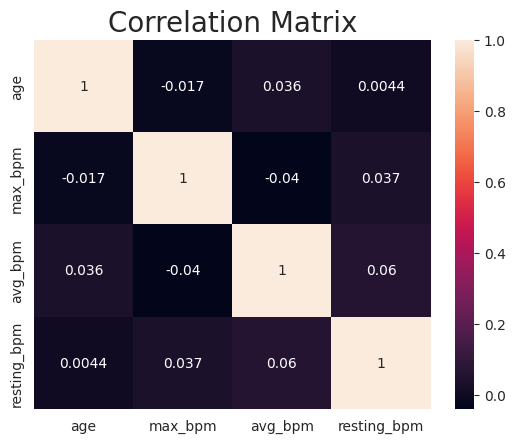

In [26]:
sns.heatmap(data[["age", "max_bpm", "avg_bpm", "resting_bpm"]].corr(), annot=True)

plt.title("Correlation Matrix", fontsize=20)

plt.show()

There is little to no correlation in these metrics so there is no pattern.

Now let's explore the session duration:

In [27]:
data["session_duration_hours"].describe()

count    973.000000
mean       1.256423
std        0.343033
min        0.500000
25%        1.040000
50%        1.260000
75%        1.460000
max        2.000000
Name: session_duration_hours, dtype: float64

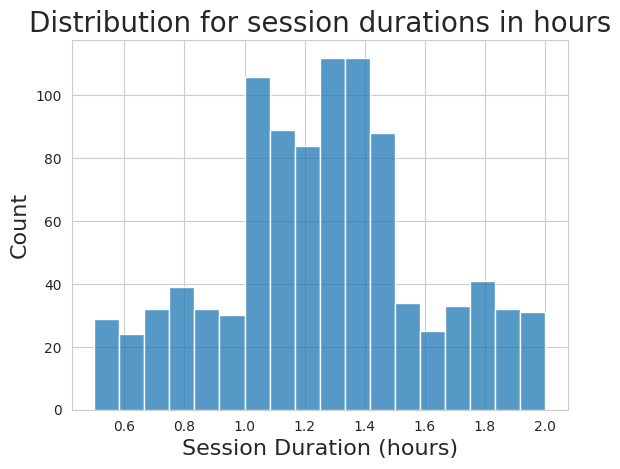

In [28]:
sns.histplot(data, x="session_duration_hours", bins="fd")

plt.title("Distribution for session durations in hours", fontsize=20)
plt.xlabel("Session Duration (hours)", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

It closely resembles a normal distribution, which is really nice.

Now let's explore the duration between men and women and look for differences:

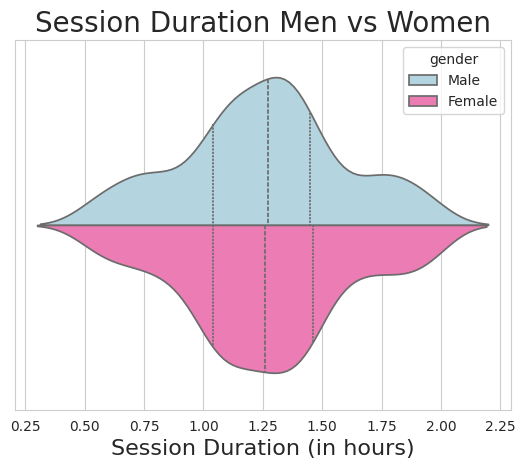

In [29]:
sns.violinplot(data, x="session_duration_hours", hue="gender", split=True, inner="quart", palette=["lightblue", "hotpink"])

plt.xlabel("Session Duration (in hours)", fontsize=16)
plt.title("Session Duration Men vs Women", fontsize=20)

plt.show()

It appears, that men and women spend the same time for training. Now let's inspect the age groups:

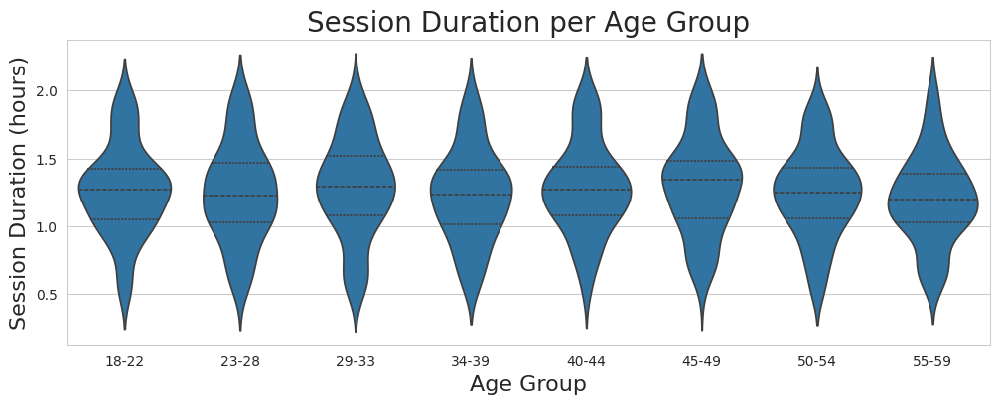

In [30]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 4))
sns.violinplot(data.sort_values("age_group"), x="age_group", y="session_duration_hours", inner="quart", ax=ax)

ax.set_title("Session Duration per Age Group", fontsize=20)
ax.set_xlabel("Age Group", fontsize=16)
ax.set_ylabel("Session Duration (hours)", fontsize=16)

plt.show()

Here the sessions are similar in duration as well. So there is no trend in session durations. I was expecting, that younger people would spend more time working out, because they have more free time overall.

Now comes the workout type. Let's look at the distribution:

In [31]:
data["workout_type"].value_counts()

workout_type
Strength    258
Cardio      255
Yoga        239
HIIT        221
Name: count, dtype: int64

They seem pretty evenly distributed. Let's see what men and women like to do more:

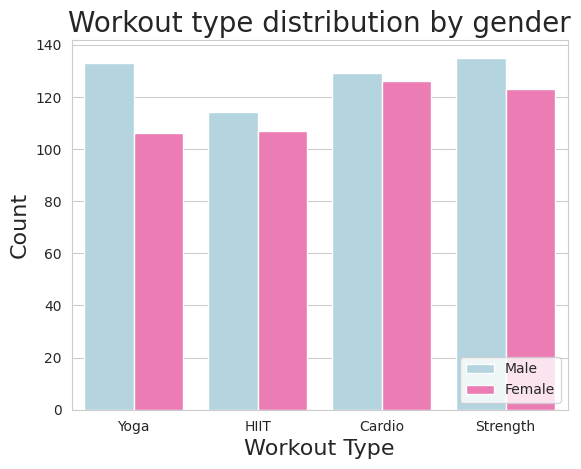

In [32]:
sns.countplot(data, x="workout_type", hue="gender", palette=["lightblue", "hotpink"])

plt.title("Workout type distribution by gender", fontsize=20)
plt.xlabel("Workout Type", fontsize=16)
plt.ylabel("Count", fontsize=16)
plt.legend(loc="lower right")

plt.show()

A big surprize here is, that men do more yoga than women, although not by that much.

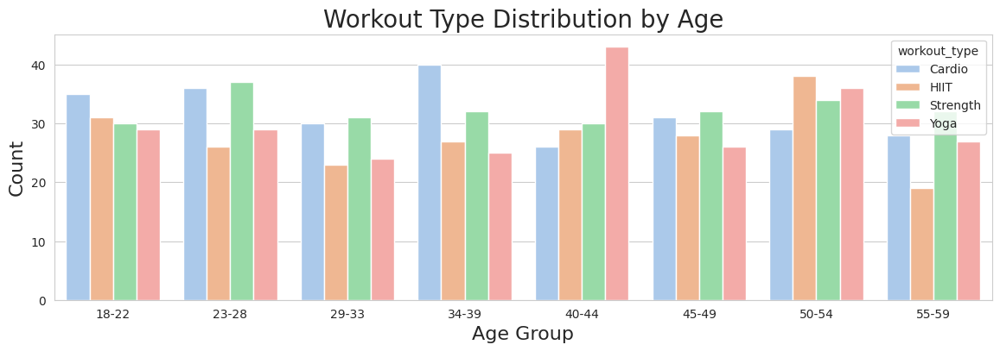

In [33]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 4))
sns.countplot(data.sort_values("age_group"), x="age_group", hue="workout_type", palette="pastel", ax=ax)

plt.title("Workout Type Distribution by Age", fontsize=20)
plt.xlabel("Age Group", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

Here we can see, that people aged between 34 and 39 years old like to do more cardio and people between 40 and 44 years old like to do more yoga.

Now we are going to explore the fat percentage. After [looking at this website](https://www.healthline.com/health/exercise-fitness/ideal-body-fat-percentage) we see that the normal body fat percentage for women is between 21 and 35 percent and between 8 and 24 for men. 

Let's draw some plots now, beginning with the fat percentage as a whole:

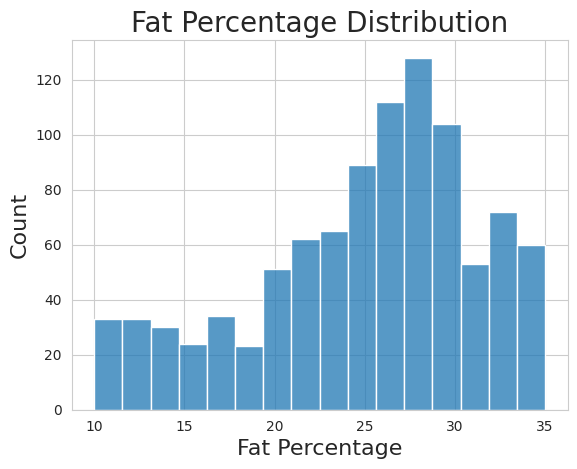

In [34]:
sns.histplot(data, x="fat_percentage", bins="fd")

plt.title("Fat Percentage Distribution", fontsize=20)
plt.xlabel("Fat Percentage", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

We can't get enough information here due to the big gender differences, let's draw a violin plot, in order to see the percentages in men and women simultaneously:

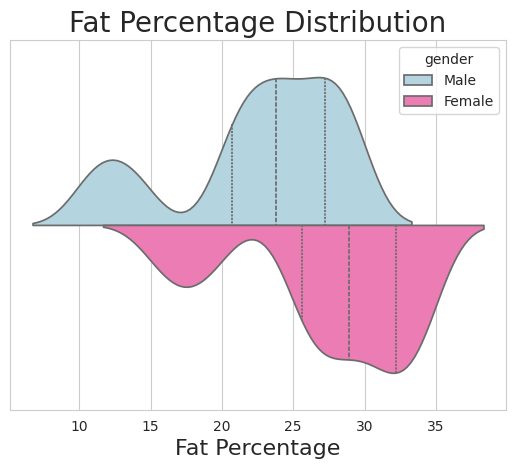

In [35]:
sns.violinplot(data, x="fat_percentage", hue="gender", palette=["lightblue", "hotpink"], split=True, inner="quart")
plt.title("Fat Percentage Distribution", fontsize=20)
plt.xlabel("Fat Percentage", fontsize=16)
plt.show()

Judging by the plot, it looks like most of the people are in the healthy ranges with a bit of a "bump" on the lower side. Now let's see exact figures:

In [36]:
male_fat_percentage_categories={
    "Essential Fat" : [2, 5.5],
    "Athlete" : [5.5, 13.5],
    "Fitness" : [13.5, 17.5],
    "Acceptable" : [17.5, 25],
    "Obese" : [25, 100]
}

female_fat_percentage_categories={
    "Essential Fat" : [10, 13.5],
    "Athlete" : [13.5, 20.5],
    "Fitness" : [20.5, 24.5],
    "Acceptable" : [24.5, 32],
    "Obese" : [32, 100]
}

In [37]:
for key, val in male_fat_percentage_categories.items():
    data.loc[(data["gender"] == "Male") & (data["fat_percentage"] > val[0]) & (data["fat_percentage"] <= val[1]), "fat_category"] = key

for key, val in female_fat_percentage_categories.items():
    data.loc[(data["gender"] == "Female") & (data["fat_percentage"] > val[0]) & (data["fat_percentage"] <= val[1]), "fat_category"] = key

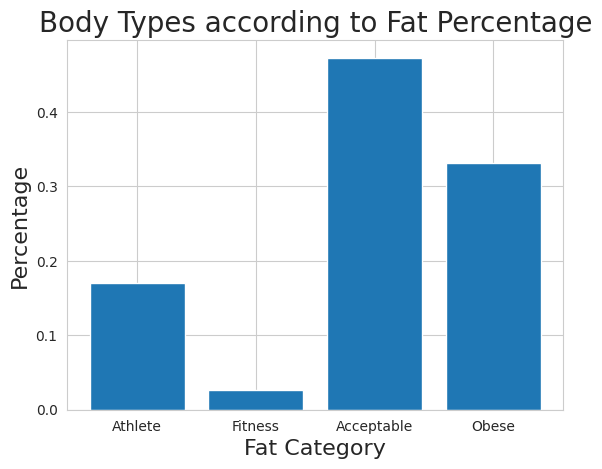

In [38]:
body_types = ["Athlete", "Fitness", "Acceptable", "Obese"]
plt.bar(x=body_types, height=[data[data["fat_category"] == body_type].shape[0] / data.shape[0] for body_type in body_types])

plt.title("Body Types according to Fat Percentage", fontsize=20)
plt.xlabel("Fat Category", fontsize=16)
plt.ylabel("Percentage", fontsize=16)

plt.show()

According to the plot, over 30% of the people in this dataset are obese. Maybe that's the reason they have decided to go to the gym.

Now let's explore people's water drinking habits:

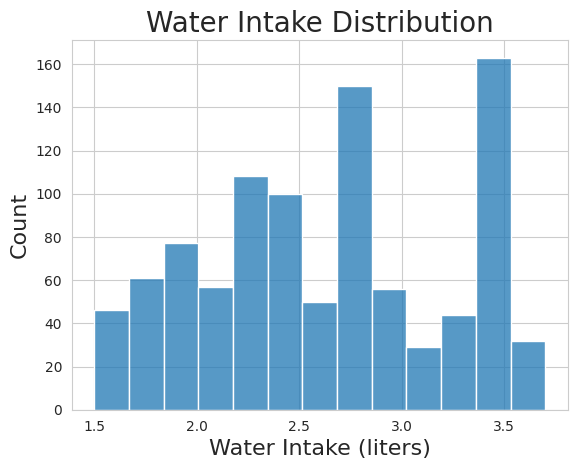

In [39]:
sns.histplot(data, x="water_intake_liters", bins="fd")

plt.title("Water Intake Distribution", fontsize=20)
plt.xlabel("Water Intake (liters)", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

The general trend is higher than expected with a big peak in people drinking around 3.5 liters. Again, let's plot the differences between the genders:

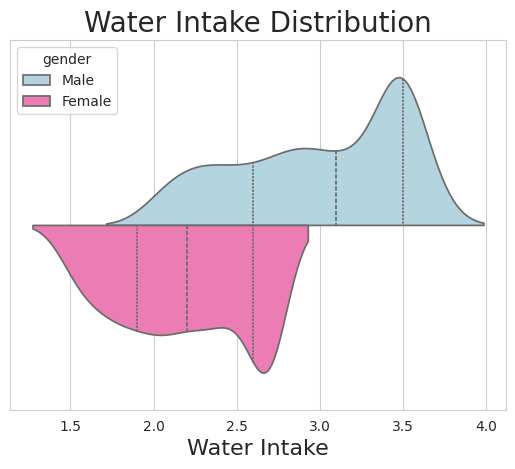

In [40]:
sns.violinplot(data, x="water_intake_liters", hue="gender", palette=["lightblue", "hotpink"], split=True, inner="quart")
plt.title("Water Intake Distribution", fontsize=20)
plt.xlabel("Water Intake", fontsize=16)
plt.show()

As expected, men drink more water. The biology textbooks didn't lie to us.

Now let's see how often people go to the gym:

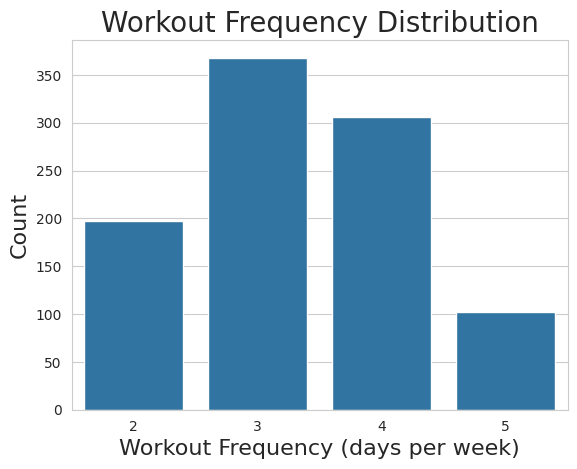

In [41]:
sns.countplot(data, x="workout_frequency_days_per_week")

plt.title("Workout Frequency Distribution", fontsize=20)
plt.xlabel("Workout Frequency (days per week)", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

Most people train 3 or 4 times a week, which is not surprising. Let's see this grouped by ages. We expect, that the youngest people would have the most time, so they would train more often.

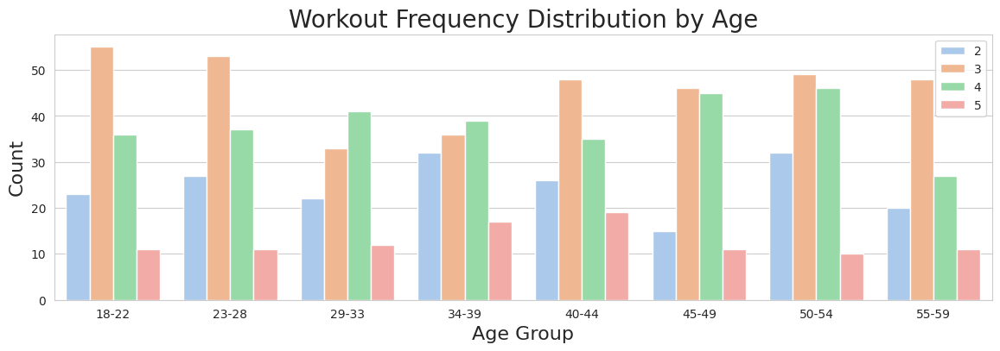

In [42]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 4))
sns.countplot(data.sort_values("age_group"), x="age_group", hue="workout_frequency_days_per_week", palette="pastel", ax=ax)

plt.title("Workout Frequency Distribution by Age", fontsize=20)
plt.xlabel("Age Group", fontsize=16)
plt.ylabel("Count", fontsize=16)
plt.legend(loc="upper right")

plt.show()

That's not really the case, though. The distributions are pretty similar.

Now let's explore the BMI and its correlation with the fat percentage and the weight of the people:

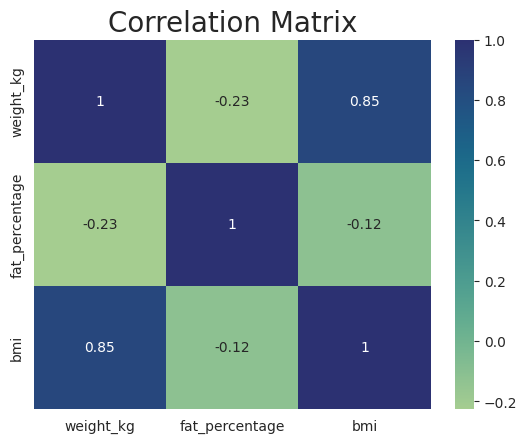

In [43]:
sns.heatmap(data[["weight_kg", "fat_percentage", "bmi"]].corr(), annot=True, cmap="crest")

plt.title("Correlation Matrix", fontsize=20)

plt.show()

We can see a big correlation between BMI and weight. Let's see this even more clearly with a scatterplot:

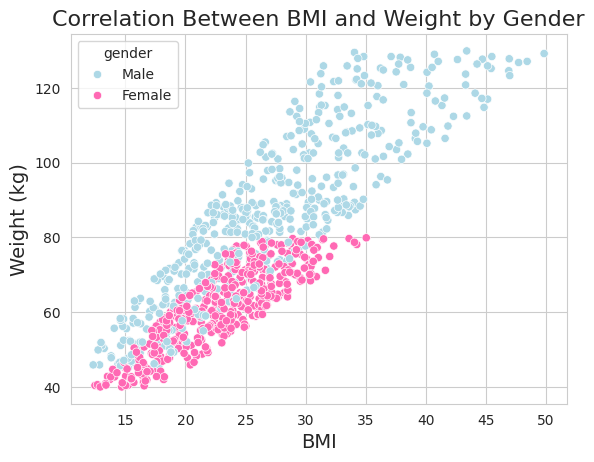

In [44]:
sns.scatterplot(data, x="bmi", y="weight_kg", hue="gender", palette=["lightblue", "hotpink"])

plt.title("Correlation Between BMI and Weight by Gender", fontsize=16)
plt.xlabel("BMI", fontsize=14)
plt.ylabel("Weight (kg)", fontsize=14)

plt.show()

The scatterplot speaks for itself here. But there are no surprises here, because BMI is calculated, based on the height and weight of people.

Now it's time to explore the burned calories, our soon-to-be target variable:

In [45]:
data["calories_burned"].describe()

count     973.000000
mean      905.422405
std       272.641516
min       303.000000
25%       720.000000
50%       893.000000
75%      1076.000000
max      1783.000000
Name: calories_burned, dtype: float64

In [46]:
data["calories_burned"].median()

893.0

These metrics resemble a normal distribution, but a histogram would make everything clearer.

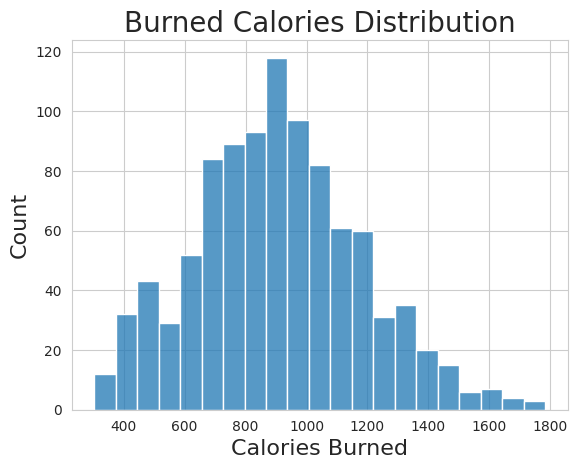

In [47]:
sns.histplot(data, x="calories_burned")

plt.title("Burned Calories Distribution", fontsize=20)
plt.xlabel("Calories Burned", fontsize=16)
plt.ylabel("Count", fontsize=16)

plt.show()

Now let's try to see some patterns. We will begin by looking at the burned calories by workout type:

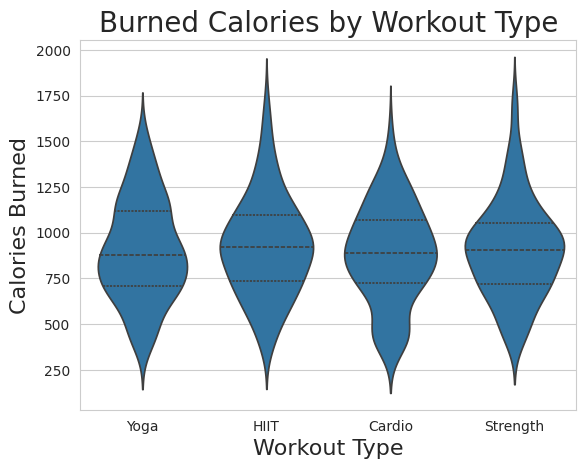

In [48]:
sns.violinplot(data, x="workout_type", y="calories_burned", inner="quart")

plt.title("Burned Calories by Workout Type", fontsize=20)
plt.xlabel("Workout Type", fontsize=16)
plt.ylabel("Calories Burned", fontsize=16)

plt.show()

Surprisingly, in general each type of workout burns roughly the same amount of calories. Let's do the same plot, but with separated genders to see if that would make a difference:

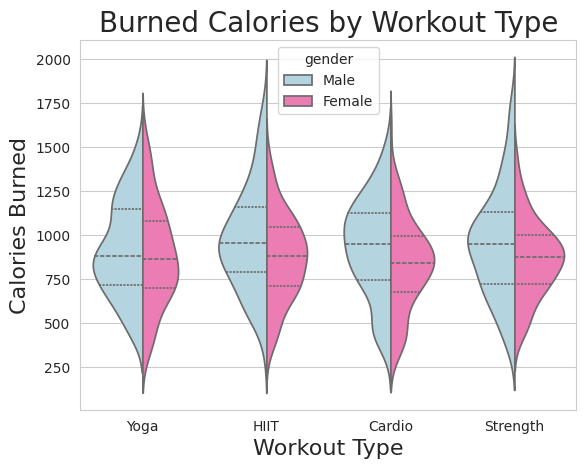

In [49]:
sns.violinplot(data, x="workout_type", y="calories_burned", hue="gender", palette=["lightblue", "hotpink"], split=True, inner="quart")

plt.title("Burned Calories by Workout Type", fontsize=20)
plt.xlabel("Workout Type", fontsize=16)
plt.ylabel("Calories Burned", fontsize=16)

plt.show()

Everywhere, except in yoga workouts, men tend to burn more calories. Now let's look into the relationship between burned calories and experience level. Maybe more experienced people would burn more calories:

In [50]:
data_renamed_experience = data
data_renamed_experience["experience_level"] = data["experience_level"].apply(lambda x : "Beginner" if x == 1 else "Intermediate" if x == 2 else "Expert")

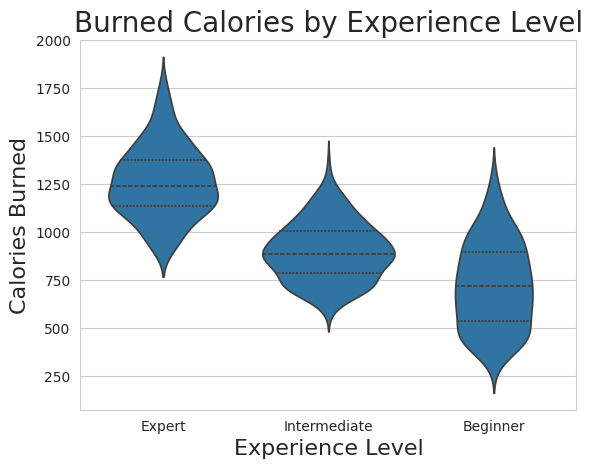

In [51]:
sns.violinplot(data_renamed_experience, x="experience_level", y="calories_burned", inner="quart")

plt.title("Burned Calories by Experience Level", fontsize=20)
plt.xlabel("Experience Level", fontsize=16)
plt.ylabel("Calories Burned", fontsize=16)

plt.show()

The difference is bigger than anticipated. Well, experts clearly know what they are doing. Now let's observe some correlations to look for dependencies:

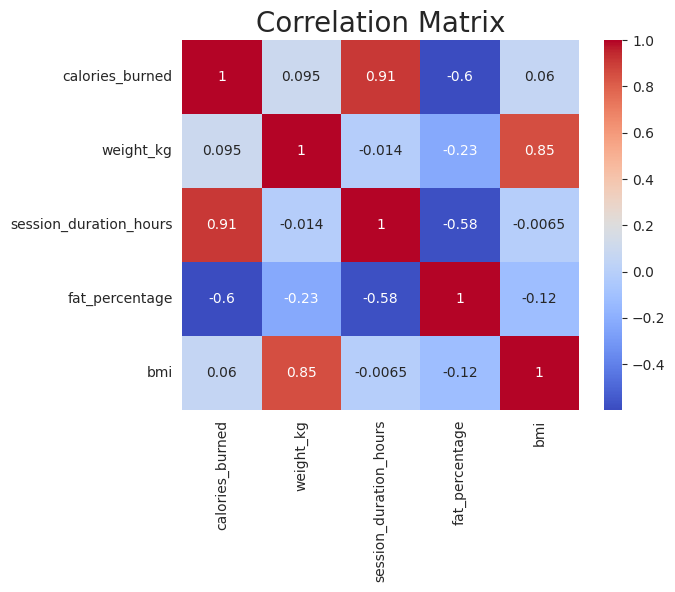

In [52]:
sns.heatmap(data[["calories_burned", "weight_kg", "session_duration_hours", "fat_percentage", "bmi"]].corr(), annot=True, cmap="coolwarm")

plt.title("Correlation Matrix", fontsize=20)

plt.show()

There are some correlations, that need a further analysis. Let's plot them:

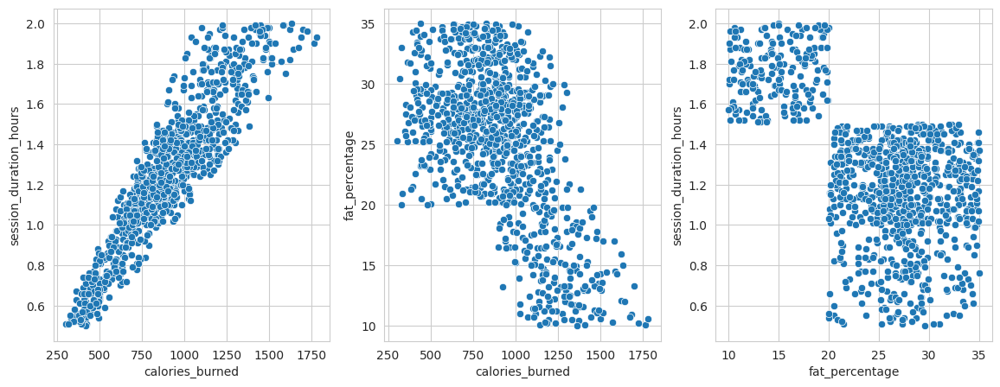

In [53]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(14,5))

sns.scatterplot(data, x="calories_burned", y="session_duration_hours", ax=axes[0])
sns.scatterplot(data, x="calories_burned", y="fat_percentage", ax=axes[1])
sns.scatterplot(data, x="fat_percentage", y="session_duration_hours", ax=axes[2])

plt.show()

In the latter two scatterplots, there is a really strange pattern and a clear distinction between something, which I suspect is the experience level. Let's inspect these one by one:

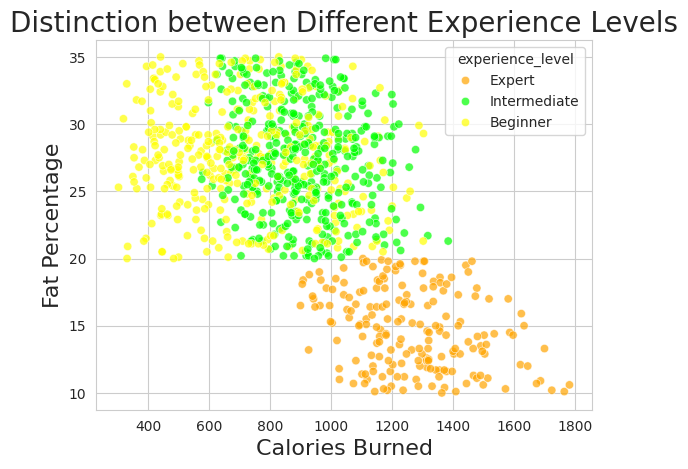

In [54]:
sns.scatterplot(data_renamed_experience, x="calories_burned", y="fat_percentage", hue="experience_level", palette=["orange", "lime", "yellow"], alpha=0.7)

plt.title("Distinction between Different Experience Levels", fontsize=20)
plt.xlabel("Calories Burned", fontsize=16)
plt.ylabel("Fat Percentage", fontsize=16)

plt.show()

The interesting thing is, that the experts are really in a league of their own with a very clear distinction between them and the rest. Now let's look into the other scatterplot, which looks even more interesting:

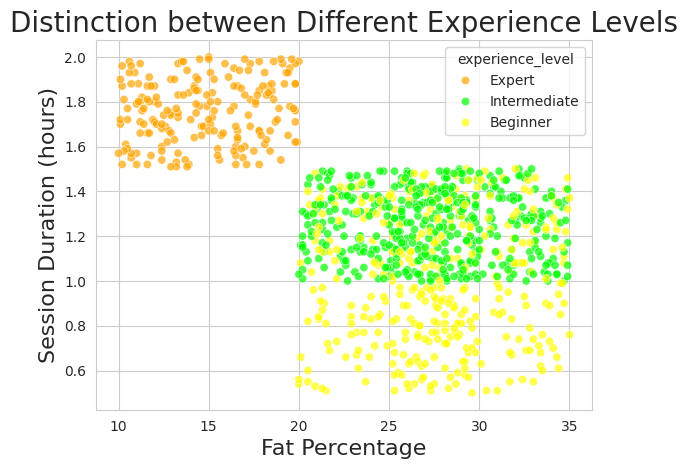

In [55]:
sns.scatterplot(data_renamed_experience, x="fat_percentage", y="session_duration_hours", hue="experience_level", palette=["orange", "lime", "yellow"], alpha=0.7)

plt.title("Distinction between Different Experience Levels", fontsize=20)
plt.xlabel("Fat Percentage", fontsize=16)
plt.ylabel("Session Duration (hours)", fontsize=16)

plt.show()

Here the distinction is even more apparent. The points are literally separated with several lines, which is very strange.

As we just found out, experts do things really differently from the rest. Let's explore this further, mixing in some other metrics. We will begin with the gender and age distributions:

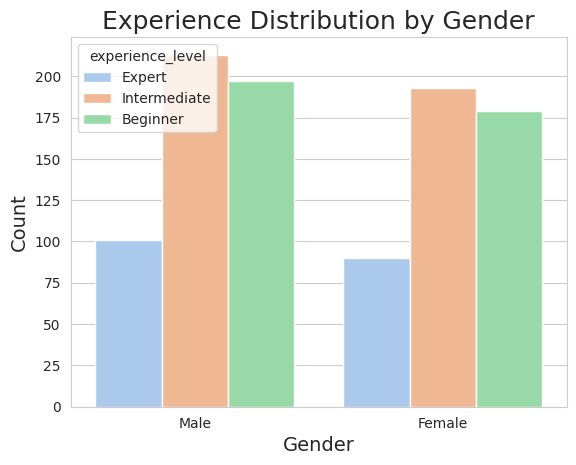

In [56]:
sns.countplot(data, x="gender", hue="experience_level", palette="pastel")

plt.title("Experience Distribution by Gender", fontsize=18)
plt.xlabel("Gender", fontsize=14)
plt.ylabel("Count", fontsize=14)

plt.show()

They are evenly distributed among genders. Now let's look into the age distribution:

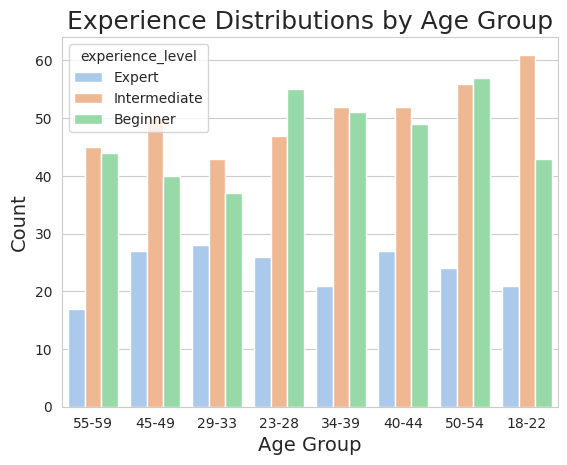

In [57]:
sns.countplot(data, x="age_group", hue="experience_level", palette="pastel")

plt.title("Experience Distributions by Age Group", fontsize=18)
plt.xlabel("Age Group", fontsize=14)
plt.ylabel("Count", fontsize=14)

plt.show()

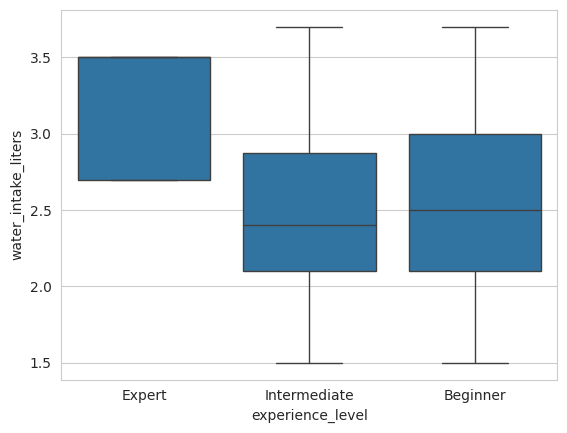

In [58]:
sns.boxplot(data_renamed_experience, x="experience_level", y="water_intake_liters")

plt.show()

This looks strange, there is no median in the expert box. Let's look into it:

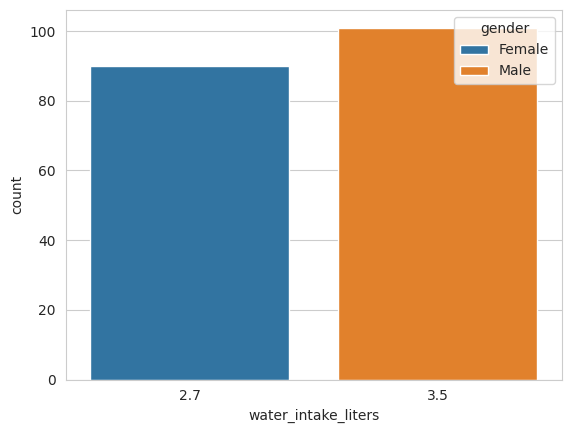

In [59]:
sns.countplot(data_renamed_experience[data_renamed_experience["experience_level"] == "Expert"], x="water_intake_liters", hue="gender")

plt.show()

Apparently, all of the male experts drink exactly 3.5 liters of water and all of the female ones drink 2.7 liters. That's strange. Now let's look into their preferred workout types:

In [60]:
data.columns

Index(['age', 'gender', 'weight_kg', 'height_m', 'max_bpm', 'avg_bpm',
       'resting_bpm', 'session_duration_hours', 'calories_burned',
       'workout_type', 'fat_percentage', 'water_intake_liters',
       'workout_frequency_days_per_week', 'experience_level', 'bmi',
       'age_group', 'fat_category'],
      dtype='object')

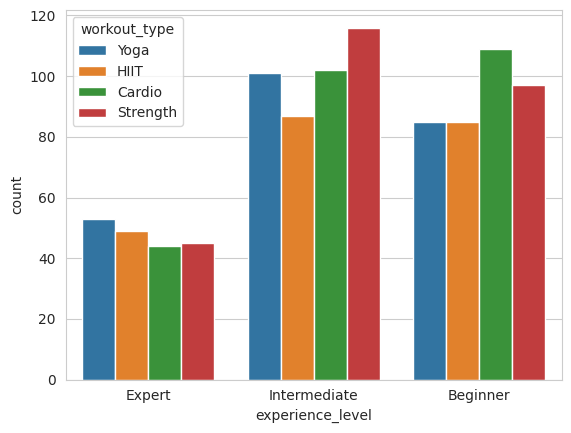

In [61]:
sns.countplot(data_renamed_experience, x="experience_level", hue="workout_type")

plt.show()

They don't seem to have a preferred workout type.

With that we conclude the EDA.

## **2. Modeling and feature selection**
Now let's create our target variable - "burned_enough_calories". It will be 0 if "calories_burned" is less than 800 and 1 if it's more than or equal to 800.

In [62]:
data_renamed_experience.loc[data["calories_burned"] < 800, "burned_enough_calories"] = 0
data_renamed_experience.loc[data["calories_burned"] >= 800, "burned_enough_calories"] = 1

Now let's see if there would be a big class imbalance:

In [63]:
data_renamed_experience["burned_enough_calories"].value_counts(dropna=False)

burned_enough_calories
1.0    630
0.0    343
Name: count, dtype: int64

Well, there is and we'll have to keep that in mind.

Now let's prepare our data. Let's remove the categorical features we've created, because they are derived from features we already have:

In [64]:
X = data_renamed_experience.drop(columns=["burned_enough_calories", "age_group", "fat_category", "calories_burned"])
y = data_renamed_experience["burned_enough_calories"]

In [65]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

The first model we are going to train is a Logistic Regression. Due to the dataset being really small, we can afford to do a GridSearchCV on as many hyperparameters as we want.

In [66]:
X_train_ohe = pd.get_dummies(X_train, drop_first=True)
X_val_ohe = pd.get_dummies(X_val, drop_first=True)

In [67]:
logreg_pipeline = Pipeline(
    steps=[
        ("scaler", StandardScaler()),
        ("logreg", LogisticRegression(random_state=42))
    ]
)

Here we define a KFold for all future grid searches:

In [68]:
kf = KFold(n_splits=10, shuffle=True, random_state=42)

In [69]:
logreg_param_grid = {
    "logreg__penalty" : ["l1", "l2", None],
    "logreg__C" : [0.0001, 0.001, 0.01, 0.1, 0.5, 1, 10],
    "logreg__solver" : ["lbfgs", "liblinear", "newton-cholesky"]
}

In [70]:
logreg_grid_search = GridSearchCV(
    estimator=logreg_pipeline,
    param_grid=logreg_param_grid,
    cv=kf,
    n_jobs=-1,
    verbose=4
)

In [71]:
logreg_grid_search.fit(X_train_ohe, y_train)

Fitting 10 folds for each of 63 candidates, totalling 630 fits


/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: U

GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('logreg',
                                        LogisticRegression(random_state=42))]),
             n_jobs=-1,
             param_grid={'logreg__C': [0.0001, 0.001, 0.01, 0.1, 0.5, 1, 10],
                         'logreg__penalty': ['l1', 'l2', None],
                         'logreg__solver': ['lbfgs', 'liblinear',
                                            'newton-cholesky']},
             verbose=4)

Now let's take a look at the model's performance:

In [72]:
logreg_grid_search.best_score_

0.9704295704295705

In [73]:
logreg_grid_search.best_params_

{'logreg__C': 10, 'logreg__penalty': 'l2', 'logreg__solver': 'liblinear'}

In [74]:
logreg_grid_search.score(X_val_ohe, y_val)

0.9846153846153847

That score is really high! Let's look at the other metrics:

In [75]:
y_pred = logreg_grid_search.predict(X_val_ohe)
print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

         0.0       0.99      0.97      0.98        69
         1.0       0.98      0.99      0.99       126

    accuracy                           0.98       195
   macro avg       0.98      0.98      0.98       195
weighted avg       0.98      0.98      0.98       195



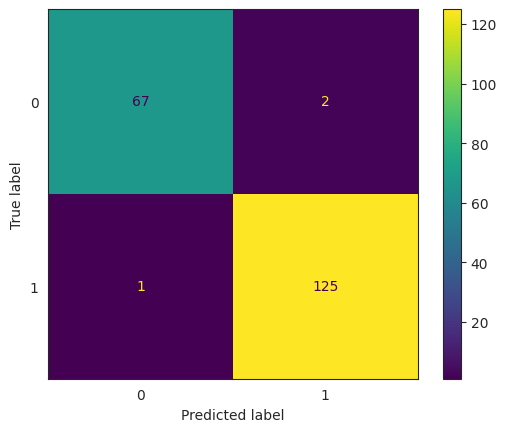

In [76]:
sns.set_style("white")
ConfusionMatrixDisplay(confusion_matrix(y_val, y_pred)).plot()
plt.show()

It's almost perfect. Let's see what's happening and what are the feature importances:

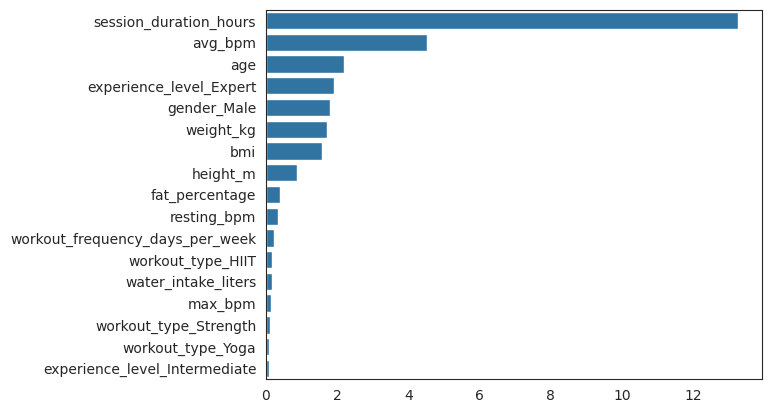

In [77]:
logreg_feature_importances = pd.Series(abs(logreg_grid_search.best_estimator_["logreg"].coef_.ravel()), index=X_train_ohe.columns)

sns.barplot(logreg_feature_importances.sort_values(ascending=False), orient="h")
plt.show()

Due to the high correlation, as expected, the session duration plays the biggest role in the model's evaluation. Now, to properly see the importances of the other metrics, let's remove this feature and run another Logistic Regression without it:

In [78]:
X_train_ohe = X_train_ohe.drop(columns=["session_duration_hours"])
X_val_ohe = X_val_ohe.drop(columns=["session_duration_hours"])

In [79]:
logreg_grid_search_no_session_duration = GridSearchCV(
    estimator=logreg_pipeline,
    param_grid=logreg_param_grid,
    cv=kf,
    n_jobs=-1,
    verbose=4
)

In [80]:
logreg_grid_search_no_session_duration.fit(X_train_ohe, y_train)

Fitting 10 folds for each of 63 candidates, totalling 630 fits


/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: U

[CV 4/10] END logreg__C=0.0001, logreg__penalty=l1, logreg__solver=lbfgs;, score=nan total time=   0.0s
[CV 9/10] END logreg__C=0.0001, logreg__penalty=l1, logreg__solver=newton-cholesky;, score=nan total time=   0.0s
[CV 5/10] END logreg__C=0.0001, logreg__penalty=l2, logreg__solver=lbfgs;, score=0.667 total time=   0.0s
[CV 1/10] END logreg__C=0.0001, logreg__penalty=l2, logreg__solver=liblinear;, score=0.782 total time=   0.0s
[CV 6/10] END logreg__C=0.0001, logreg__penalty=l2, logreg__solver=liblinear;, score=0.744 total time=   0.0s
[CV 8/10] END logreg__C=0.0001, logreg__penalty=l2, logreg__solver=newton-cholesky;, score=0.628 total time=   0.0s
[CV 7/10] END logreg__C=0.0001, logreg__penalty=None, logreg__solver=lbfgs;, score=0.974 total time=   0.0s
[CV 5/10] END logreg__C=0.0001, logreg__penalty=None, logreg__solver=liblinear;, score=nan total time=   0.0s
[CV 3/10] END logreg__C=0.001, logreg__penalty=l1, logreg__solver=lbfgs;, score=nan total time=   0.0s
[CV 4/10] END logre

/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/gecata/.local/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1208: U

GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('logreg',
                                        LogisticRegression(random_state=42))]),
             n_jobs=-1,
             param_grid={'logreg__C': [0.0001, 0.001, 0.01, 0.1, 0.5, 1, 10],
                         'logreg__penalty': ['l1', 'l2', None],
                         'logreg__solver': ['lbfgs', 'liblinear',
                                            'newton-cholesky']},
             verbose=4)

In [81]:
logreg_grid_search_no_session_duration.best_params_

{'logreg__C': 0.1, 'logreg__penalty': 'l2', 'logreg__solver': 'liblinear'}

Okay, we got a different result. Let's look at the score now:

In [82]:
logreg_grid_search_no_session_duration.best_score_

0.760905760905761

In [83]:
logreg_grid_search_no_session_duration.score(X_val_ohe, y_val)

0.7435897435897436

Here the model performs much worse. But before jumping to conclusions, let's look at its other metrics first:

In [84]:
y_pred = logreg_grid_search_no_session_duration.predict(X_val_ohe)

print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

         0.0       0.66      0.58      0.62        69
         1.0       0.78      0.83      0.81       126

    accuracy                           0.74       195
   macro avg       0.72      0.71      0.71       195
weighted avg       0.74      0.74      0.74       195



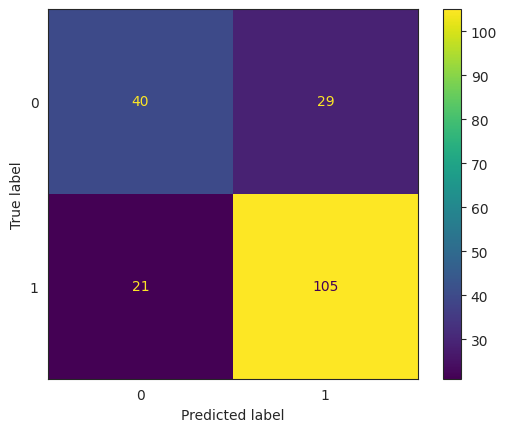

In [85]:
sns.set_style("white")
cm = confusion_matrix(y_val, y_pred)
ConfusionMatrixDisplay(cm).plot()
plt.show()

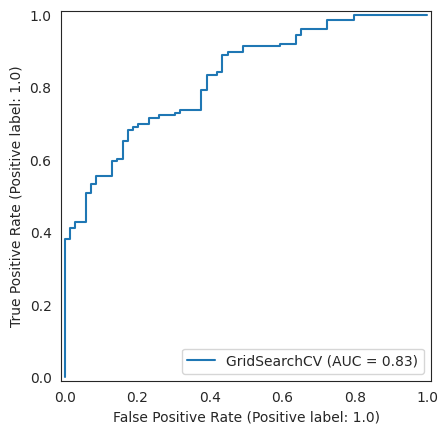

In [130]:
RocCurveDisplay.from_estimator(logreg_grid_search_no_session_duration, X=X_val_ohe, y=y_val)
plt.show()

These are not the best results, but let's still look at the feature importances:

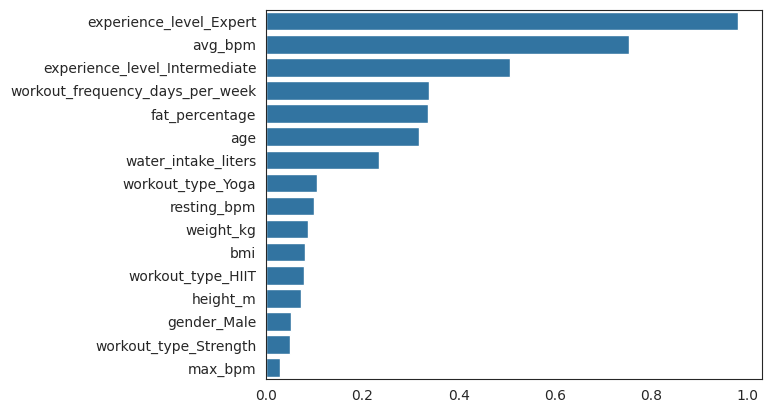

In [86]:
logreg_feature_importances = pd.Series(abs(logreg_grid_search_no_session_duration.best_estimator_["logreg"].coef_.ravel()), index=X_train_ohe.columns)

sns.barplot(logreg_feature_importances.sort_values(ascending=False), orient="h")
plt.show()

Here it seems, that the most important feature is the experience level, especially being an "Expert". Judging by the analysis we've done beforehand, that's not surprising at all.

Now let's see if we can get another model to perform better. We are going to try a Decision Tree:

In [88]:
tree = DecisionTreeClassifier(random_state=42)

In [89]:
param_grid = {
    "criterion" : ["gini", "entropy", "log_loss"],
    "max_depth" : [3, 4, 5, 7, 9, 10, 12, 15, None],
    "min_samples_split" : [2, 5, 10, 15, 20],
    "max_features" : ["sqrt", "log2", None],
    "class_weight" : ["balanced", None]
}

In [90]:
tree_grid_search = GridSearchCV(
    estimator=tree,
    param_grid=param_grid,
    cv=kf,
    scoring="f1",
    n_jobs=-1
)

In [91]:
tree_grid_search.fit(X_train_ohe, y_train)

GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'class_weight': ['balanced', None],
                         'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [3, 4, 5, 7, 9, 10, 12, 15, None],
                         'max_features': ['sqrt', 'log2', None],
                         'min_samples_split': [2, 5, 10, 15, 20]},
             scoring='f1')

Now that it's ready, let's take a look at its parameters:

In [92]:
tree_grid_search.best_params_

{'class_weight': None,
 'criterion': 'gini',
 'max_depth': 3,
 'max_features': None,
 'min_samples_split': 2}

That's interesting. I didn't expect such a low depth to be the best. Let's look at some metrics:

In [93]:
tree_grid_search.best_score_

0.8191375456309192

In [94]:
tree_grid_search.score(X_train_ohe, y_train)

0.8235294117647058

In [95]:
tree_grid_search.score(X_val_ohe, y_val)

0.8275862068965517

In [96]:
y_pred = tree_grid_search.predict(X_val_ohe)
print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

         0.0       0.81      0.36      0.50        69
         1.0       0.73      0.95      0.83       126

    accuracy                           0.74       195
   macro avg       0.77      0.66      0.66       195
weighted avg       0.76      0.74      0.71       195



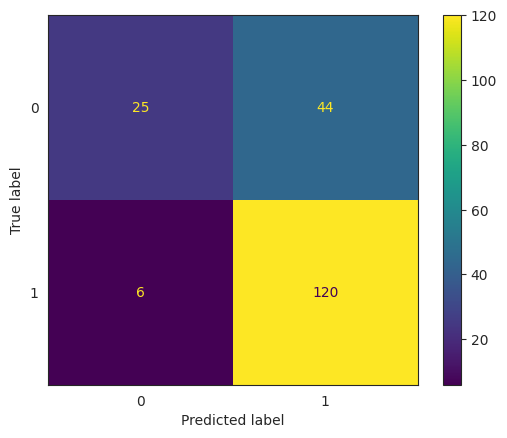

In [97]:
cm = confusion_matrix(y_val, y_pred)
ConfusionMatrixDisplay(cm).plot()
plt.show()

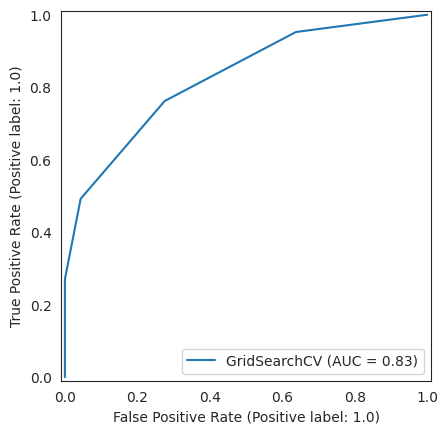

In [131]:
RocCurveDisplay.from_estimator(tree_grid_search, X_val_ohe, y_val)
plt.show()

Well that's actually a bit worse than the Logistic Regression. Let's look at its feature importances anyway:

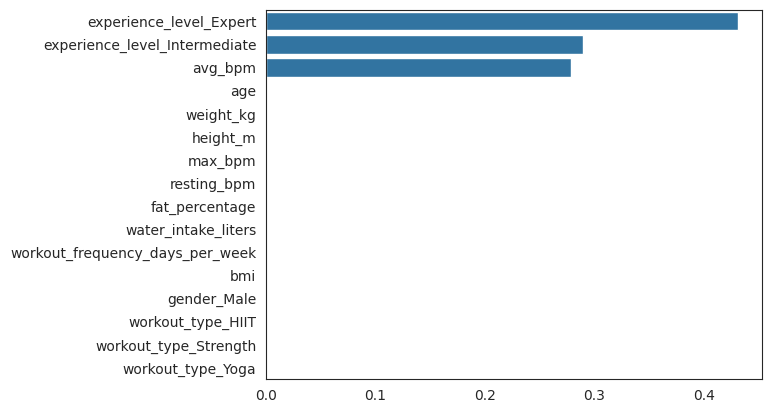

In [99]:
tree_feature_importances = pd.Series(tree_grid_search.best_estimator_.feature_importances_, index=X_train_ohe.columns)

sns.barplot(tree_feature_importances.sort_values(ascending=False), orient="h")
plt.show()

The results are actually not that surprising, given the scatterplots we drew earlier. The interesting thing is, that the next important feature is the average BPM, which we did not find in the EDA to be the most informative, although the Logistic Regression also told us, that it's important. Let's now take a look at the tree and then a scatterplot, showing us the dependency between the metrics:

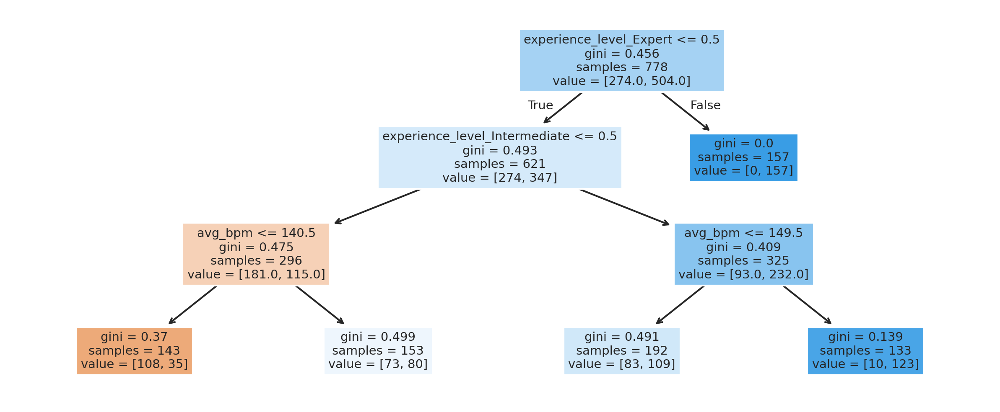

In [100]:
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (10,4), dpi=300)

plot_tree(tree_grid_search.best_estimator_, feature_names=X_train_ohe.columns, filled=True)
plt.show()

Basically, this tree separates people by experience level first and then separates by the averge BPM. Makes sense. Let's see a scatterplot and decide if it's adequate enough:

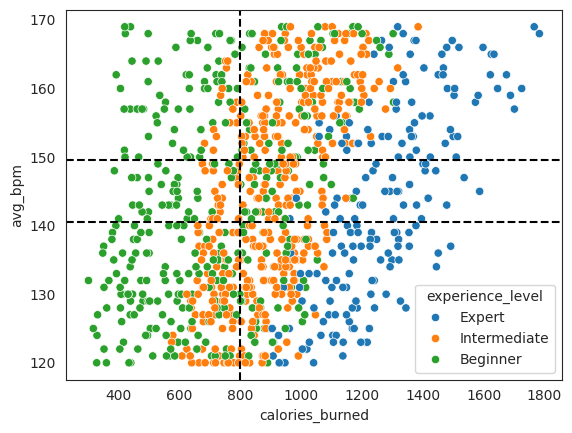

In [101]:
sns.scatterplot(data_renamed_experience, x="calories_burned", y="avg_bpm", hue="experience_level")
plt.axvline(x=800, c="black", ls="--")
plt.axhline(y=140.5, c="black", ls="--")
plt.axhline(y=149.5, c="black", ls="--")
plt.show()

Well, there is some dependency between the variables, but the points are too meshed together to clearly separate them just by these features.

So a tree isn't enough to best determine the burned calories and the feature importances. Let's try with an ensemble model like Random Forest:

In [102]:
random_forest = RandomForestClassifier(random_state=42, n_jobs=-1)

In [103]:
param_grid = {
    "n_estimators" : [10, 20, 50, 100, 150, 200],
    "criterion" : ["gini", "entropy", "log_loss"],
    "max_depth" : [3, 4, 5, 7, 9, None],
    "min_samples_split" : [2, 5, 10, 15, 20],
    "max_features" : ["sqrt", "log2", None],
    "class_weight" : ["balanced", None]
}

In [104]:
random_forest_grid_search = GridSearchCV(
    estimator=random_forest,
    param_grid=param_grid,
    cv=kf,
    scoring="f1",
    n_jobs=-1,
    verbose=4
)

In [105]:
random_forest_grid_search.fit(X_train_ohe, y_train)

Fitting 10 folds for each of 3240 candidates, totalling 32400 fits
[CV 8/10] END logreg__C=0.0001, logreg__penalty=l1, logreg__solver=lbfgs;, score=nan total time=   0.0s
[CV 9/10] END logreg__C=0.001, logreg__penalty=l2, logreg__solver=lbfgs;, score=0.662 total time=   0.0s
[CV 10/10] END logreg__C=0.001, logreg__penalty=l2, logreg__solver=lbfgs;, score=0.688 total time=   0.0s
[CV 9/10] END logreg__C=0.001, logreg__penalty=None, logreg__solver=liblinear;, score=nan total time=   0.0s
[CV 10/10] END logreg__C=0.001, logreg__penalty=None, logreg__solver=liblinear;, score=nan total time=   0.0s
[CV 1/10] END logreg__C=0.001, logreg__penalty=None, logreg__solver=newton-cholesky;, score=0.974 total time=   0.0s
[CV 2/10] END logreg__C=0.001, logreg__penalty=None, logreg__solver=newton-cholesky;, score=0.949 total time=   0.0s
[CV 1/10] END logreg__C=0.01, logreg__penalty=l2, logreg__solver=liblinear;, score=0.949 total time=   0.0s
[CV 2/10] END logreg__C=0.01, logreg__penalty=l2, logreg_

GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'class_weight': ['balanced', None],
                         'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [3, 4, 5, 7, 9, None],
                         'max_features': ['sqrt', 'log2', None],
                         'min_samples_split': [2, 5, 10, 15, 20],
                         'n_estimators': [10, 20, 50, 100, 150, 200]},
             scoring='f1', verbose=4)

In [106]:
random_forest_grid_search.best_params_

{'class_weight': None,
 'criterion': 'gini',
 'max_depth': 4,
 'max_features': 'sqrt',
 'min_samples_split': 20,
 'n_estimators': 150}

Again, the trees are pretty shallow, just as with the single tree. Let's look at some metrics to see if performance has improved:

In [107]:
random_forest_grid_search.best_score_

0.8205742803819922

In [108]:
random_forest_grid_search.score(X_train_ohe, y_train)

0.8574091332712023

In [109]:
random_forest_grid_search.score(X_val_ohe, y_val)

0.8131868131868132

In [110]:
y_pred = random_forest_grid_search.predict(X_val_ohe)

print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

         0.0       0.69      0.48      0.56        69
         1.0       0.76      0.88      0.81       126

    accuracy                           0.74       195
   macro avg       0.72      0.68      0.69       195
weighted avg       0.73      0.74      0.73       195



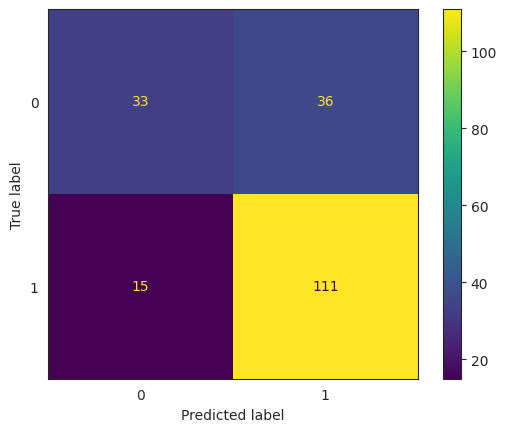

In [111]:
cm = confusion_matrix(y_val, y_pred)
ConfusionMatrixDisplay(cm).plot()
plt.show()

The results are kind of similar again. Let's look at the feature importances once again:

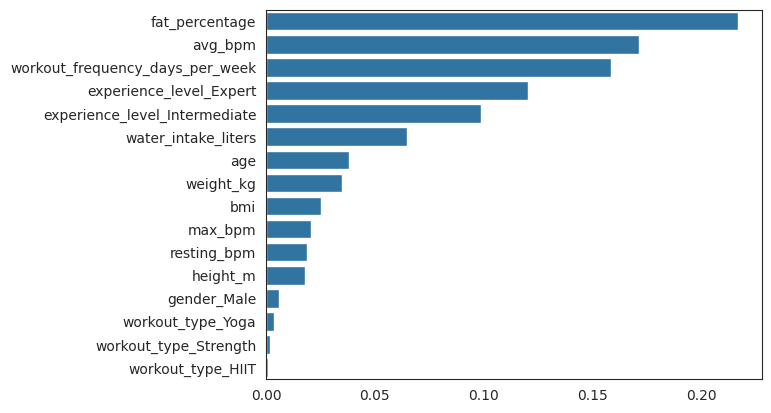

In [112]:
random_forest_feature_importances = pd.Series(random_forest_grid_search.best_estimator_.feature_importances_, index=X_train_ohe.columns)

sns.barplot(random_forest_feature_importances.sort_values(ascending=False), orient="h")
plt.show()

This showed different results. It said, that the most important metric is the fat percentage. It makes sense if we look at the scatterplot from the EDA again. Another important metric is the workout frequency. Let's plot this:

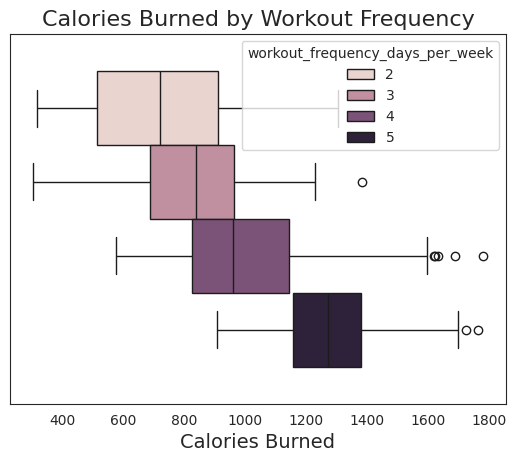

In [113]:
sns.boxplot(data, x="calories_burned", hue="workout_frequency_days_per_week")

plt.title("Calories Burned by Workout Frequency", fontsize=16)
plt.xlabel("Calories Burned", fontsize=14)

plt.show()

So, people who train more often tend to burn more calories in their workouts.

Now let's try CatBoost:

In [114]:
cat_boost = CatBoostClassifier(
    random_seed=42,
)

In [115]:
param_grid = {
    "iterations" : [50, 100, 200, 500, 1000, None],
    "max_depth" : [3, 4, 5, 7, 10, None],
}

In [116]:
cat_boost_grid_search = GridSearchCV(
    estimator=cat_boost,
    param_grid=param_grid,
    cv=kf,
    scoring="f1",
    n_jobs=-1,
    verbose=4
)

In [117]:
cat_features = list(X_train.select_dtypes(exclude=np.number).columns)

In [118]:
cat_boost_grid_search.fit(X_train.drop(columns=["session_duration_hours"]), y_train, cat_features=cat_features)

Fitting 10 folds for each of 36 candidates, totalling 360 fits
[CV 8/10] END class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, min_samples_split=5, n_estimators=100;, score=0.830 total time=   0.3s
[CV 2/10] END class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, min_samples_split=5, n_estimators=200;, score=0.775 total time=   0.6s
[CV 10/10] END class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, min_samples_split=10, n_estimators=20;, score=0.819 total time=   0.1s
[CV 10/10] END class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, min_samples_split=10, n_estimators=50;, score=0.830 total time=   0.2s
[CV 3/10] END class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, min_samples_split=10, n_estimators=150;, score=0.787 total time=   0.5s
[CV 8/10] END class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, min_samples_split=10, n_estimators=200;, score=0.81

/home/gecata/.local/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


129:	learn: 0.4827585	total: 1.78s	remaining: 11.9s
130:	learn: 0.4822509	total: 1.82s	remaining: 12.1s
131:	learn: 0.4817829	total: 1.83s	remaining: 12s
132:	learn: 0.4809100	total: 1.86s	remaining: 12.1s
133:	learn: 0.4805585	total: 1.87s	remaining: 12.1s
134:	learn: 0.4798672	total: 1.88s	remaining: 12s
135:	learn: 0.4789966	total: 1.91s	remaining: 12.1s
136:	learn: 0.4783134	total: 1.91s	remaining: 12s
137:	learn: 0.4779321	total: 1.91s	remaining: 11.9s
138:	learn: 0.4771827	total: 1.92s	remaining: 11.9s
139:	learn: 0.4764222	total: 1.96s	remaining: 12s
140:	learn: 0.4757291	total: 1.98s	remaining: 12s
141:	learn: 0.4752931	total: 1.98s	remaining: 12s
142:	learn: 0.4745983	total: 2.02s	remaining: 12.1s
143:	learn: 0.4742994	total: 2.02s	remaining: 12s
144:	learn: 0.4739492	total: 2.06s	remaining: 12.2s
145:	learn: 0.4736123	total: 2.1s	remaining: 12.3s
146:	learn: 0.4733772	total: 2.17s	remaining: 12.6s
147:	learn: 0.4728474	total: 2.17s	remaining: 12.5s
148:	learn: 0.4721120	total

GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=<catboost.core.CatBoostClassifier object at 0x7f32682a4f80>,
             n_jobs=-1,
             param_grid={'iterations': [50, 100, 200, 500, 1000, None],
                         'max_depth': [3, 4, 5, 7, 10, None]},
             scoring='f1', verbose=4)

In [120]:
cat_boost_grid_search.best_params_

{'iterations': 50, 'max_depth': 4}

Again, the trees are really shallow with a depth of 4. Let's look at the metrics:

In [121]:
cat_boost_grid_search.best_score_

0.8248418746694253

In [122]:
cat_boost_grid_search.score(X_train.drop(columns=["session_duration_hours"]), y_train)

0.8557784145176696

In [124]:
cat_boost_grid_search.score(X_val.drop(columns=["session_duration_hours"]), y_val)

0.8045112781954887

In [126]:
y_pred = cat_boost_grid_search.predict(X_val.drop(columns=["session_duration_hours"]))

print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

         0.0       0.65      0.52      0.58        69
         1.0       0.76      0.85      0.80       126

    accuracy                           0.73       195
   macro avg       0.71      0.69      0.69       195
weighted avg       0.73      0.73      0.73       195



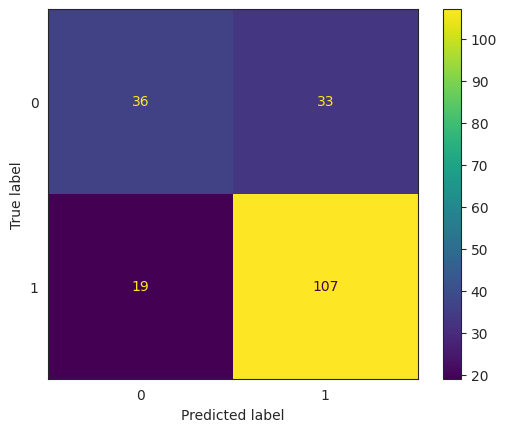

In [127]:
cm = confusion_matrix(y_val, y_pred)
ConfusionMatrixDisplay(cm).plot()
plt.show()

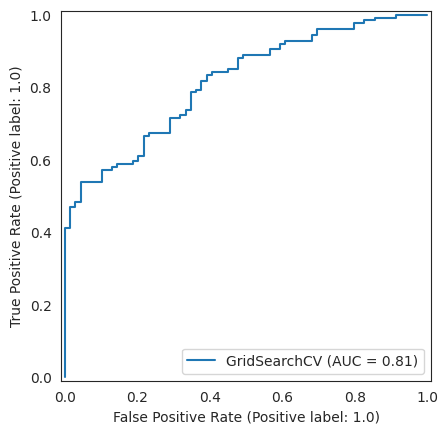

In [128]:
RocCurveDisplay.from_estimator(cat_boost_grid_search, X_val.drop(columns=["session_duration_hours"]), y_val)
plt.show()

Here the results are not much better, but still better. Let's look at the feature importances again:

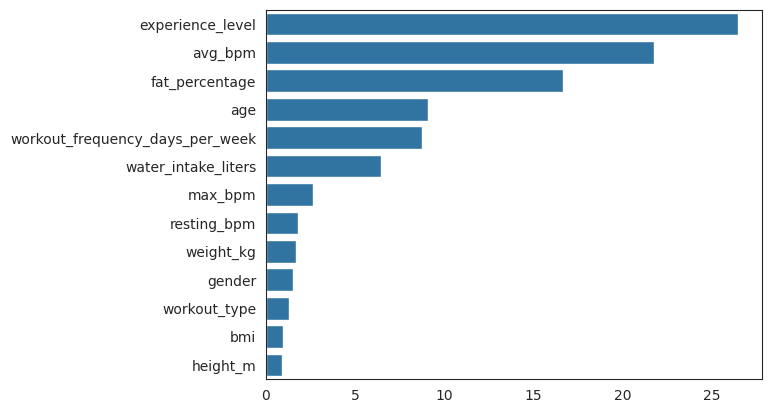

In [132]:
cat_boost_feature_importances = pd.Series(cat_boost_grid_search.best_estimator_.feature_importances_, index=X_train.drop(columns=["session_duration_hours"]).columns)

sns.barplot(cat_boost_feature_importances.sort_values(ascending=False), orient="h")
plt.show()

Again, mostly the same results. The three top features still remain on top.

Now it's time to try an SVM model:

In [133]:
svc_pipeline = Pipeline(
    steps=[
        ("scaler", StandardScaler()),
        ("svc", SVC())
    ]
)

In [134]:
param_grid = {
    "svc__C" : [0.0001, 0.001, 0.01, 0.1, 0.5, 1, 5, 10, 100, 500],
    "svc__kernel" : ["linear", "poly", "rbf", "sigmoid"],
    "svc__gamma" : ["scale", "auto", 0.0001, 0.001, 0.01, 0.1, 0.5, 1, 2, 5, 10],
    "svc__class_weight" : ["balanced", None]
}

In [135]:
svc_grid_search = GridSearchCV(
    estimator=svc_pipeline,
    param_grid=param_grid,
    cv=kf,
    scoring="f1",
    n_jobs=-1,
    verbose=4
)

In [136]:
svc_grid_search.fit(X_train_ohe, y_train)

Fitting 10 folds for each of 880 candidates, totalling 8800 fits
[CV 2/10] END svc__C=0.0001, svc__class_weight=balanced, svc__gamma=scale, svc__kernel=poly;, score=0.853 total time=   0.0s
[CV 1/10] END svc__C=0.0001, svc__class_weight=balanced, svc__gamma=auto, svc__kernel=linear;, score=0.818 total time=   0.0s
[CV 1/10] END svc__C=0.0001, svc__class_weight=balanced, svc__gamma=auto, svc__kernel=poly;, score=0.818 total time=   0.0s
[CV 8/10] END svc__C=0.0001, svc__class_weight=balanced, svc__gamma=auto, svc__kernel=rbf;, score=0.000 total time=   0.0s
[CV 5/10] END svc__C=0.0001, svc__class_weight=balanced, svc__gamma=0.0001, svc__kernel=linear;, score=0.000 total time=   0.0s
[CV 6/10] END svc__C=0.0001, svc__class_weight=balanced, svc__gamma=0.0001, svc__kernel=linear;, score=0.000 total time=   0.0s
[CV 7/10] END svc__C=0.0001, svc__class_weight=balanced, svc__gamma=0.0001, svc__kernel=sigmoid;, score=0.732 total time=   0.0s
[CV 8/10] END svc__C=0.0001, svc__class_weight=balan

GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('svc', SVC())]),
             n_jobs=-1,
             param_grid={'svc__C': [0.0001, 0.001, 0.01, 0.1, 0.5, 1, 5, 10,
                                    100, 500],
                         'svc__class_weight': ['balanced', None],
                         'svc__gamma': ['scale', 'auto', 0.0001, 0.001, 0.01,
                                        0.1, 0.5, 1, 2, 5, 10],
                         'svc__kernel': ['linear', 'poly', 'rbf', 'sigmoid']},
             scoring='f1', verbose=4)

In [137]:
svc_grid_search.best_params_

{'svc__C': 0.001,
 'svc__class_weight': None,
 'svc__gamma': 0.5,
 'svc__kernel': 'poly'}

In [138]:
svc_grid_search.best_score_

0.8234858972711352

In [139]:
svc_grid_search.score(X_train_ohe, y_train)

0.8785578747628083

In [140]:
svc_grid_search.score(X_val_ohe, y_val)

0.8178438661710037

Here it looks like it overfitted a bit. Let's dive deeper:

In [141]:
y_pred = svc_grid_search.predict(X_val_ohe)

print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

         0.0       0.69      0.52      0.60        69
         1.0       0.77      0.87      0.82       126

    accuracy                           0.75       195
   macro avg       0.73      0.70      0.71       195
weighted avg       0.74      0.75      0.74       195



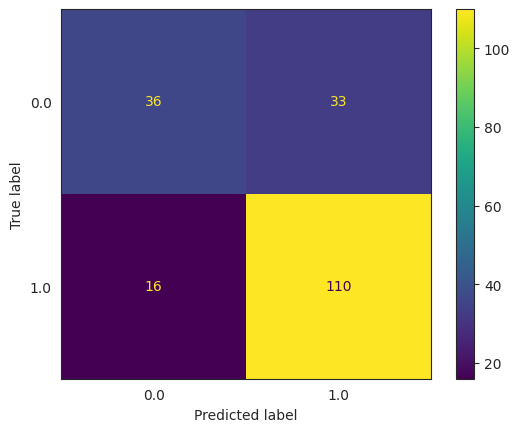

In [142]:
ConfusionMatrixDisplay.from_predictions(y_val, y_pred)
plt.show()

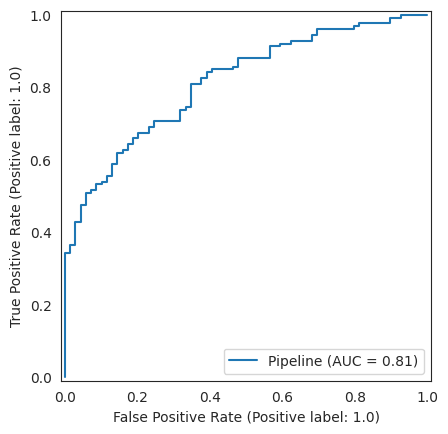

In [143]:
RocCurveDisplay.from_estimator(svc_grid_search.best_estimator_, X_val_ohe, y_val)
plt.show()

This performed a bit worse than the others, which is surprising, given how versatile SVMs are in general.

Now at last, we are going to try KNN and then select only a few features to test the models again:

In [144]:
knn_pipeline = Pipeline(
    steps=[
        ("scaler", StandardScaler()),
        ("knn", KNeighborsClassifier())
])

In [145]:
knn_param_grid = {
    "knn__n_neighbors" : range(2, 20)
}

In [146]:
knn_grid_search = GridSearchCV(
    estimator=knn_pipeline,
    param_grid=knn_param_grid,
    cv=kf,
    scoring="f1",
    n_jobs=-1,
    verbose=4
)

In [147]:
knn_grid_search.fit(X_train_ohe, y_train)

Fitting 10 folds for each of 18 candidates, totalling 180 fits
[CV 9/10] END svc__C=100, svc__class_weight=None, svc__gamma=0.001, svc__kernel=poly;, score=0.768 total time=   0.0s
[CV 1/10] END svc__C=100, svc__class_weight=None, svc__gamma=0.001, svc__kernel=rbf;, score=0.865 total time=   0.0s
[CV 3/10] END svc__C=100, svc__class_weight=None, svc__gamma=0.001, svc__kernel=rbf;, score=0.792 total time=   0.0s
[CV 6/10] END svc__C=100, svc__class_weight=None, svc__gamma=0.001, svc__kernel=rbf;, score=0.740 total time=   0.0s
[CV 9/10] END svc__C=100, svc__class_weight=None, svc__gamma=0.001, svc__kernel=rbf;, score=0.821 total time=   0.0s
[CV 2/10] END svc__C=100, svc__class_weight=None, svc__gamma=0.001, svc__kernel=sigmoid;, score=0.793 total time=   0.0s
[CV 1/10] END svc__C=100, svc__class_weight=None, svc__gamma=0.01, svc__kernel=linear;, score=0.846 total time=   0.5s
[CV 2/10] END svc__C=100, svc__class_weight=None, svc__gamma=0.01, svc__kernel=linear;, score=0.793 total time=

/home/gecata/.local/lib/python3.12/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('knn', KNeighborsClassifier())]),
             n_jobs=-1, param_grid={'knn__n_neighbors': range(2, 20)},
             scoring='f1', verbose=4)

In [148]:
knn_grid_search.best_params_

{'knn__n_neighbors': 13}

In [149]:
knn_grid_search.best_score_

0.8005863876397431

It doesn't look that promising. Let's see the other metrics:

In [150]:
knn_grid_search.score(X_train_ohe, y_train)

0.8396501457725948

In [151]:
knn_grid_search.score(X_val_ohe, y_val)

0.7816091954022989

The best model we've found is the CatBoost. Now let's try to pick only the most important features in order to attempt to make it better by reducing some noise:

In [152]:
X_selected_features = X[["experience_level", "avg_bpm", "workout_frequency_days_per_week", "fat_percentage"]]

In [153]:
X_train_selected_features, X_val_selected_features, y_train_selected_features, y_val_selected_features = train_test_split(
    X_selected_features,
    y,
    test_size=0.2,
    stratify=y,
    random_state=42
)

In [154]:
cat_boost_selected_features = CatBoostClassifier(
    random_seed=42,
    
)

In [155]:
cat_boost_selected_features_param_grid = {
    "iterations" : [50, 100, 200, 500, 1000, None],
    "max_depth" : [3, 4, 5, 7, 10, None],
}

In [156]:
cat_boost_selected_features_grid_search = GridSearchCV(
    estimator=cat_boost_selected_features,
    param_grid=cat_boost_selected_features_param_grid,
    cv=kf,
    scoring="f1",
    n_jobs=-1,
    verbose=4
)

In [157]:
cat_boost_selected_features_grid_search.fit(
    X_train_selected_features,
    y_train_selected_features,
    cat_features=["experience_level"]
)

Fitting 10 folds for each of 36 candidates, totalling 360 fits
[CV 4/10] END svc__C=500, svc__class_weight=None, svc__gamma=0.001, svc__kernel=poly;, score=0.818 total time=   0.0s
[CV 5/10] END svc__C=500, svc__class_weight=None, svc__gamma=0.001, svc__kernel=poly;, score=0.800 total time=   0.0s
[CV 6/10] END svc__C=500, svc__class_weight=None, svc__gamma=0.001, svc__kernel=poly;, score=0.752 total time=   0.0s
[CV 7/10] END svc__C=500, svc__class_weight=None, svc__gamma=0.001, svc__kernel=poly;, score=0.732 total time=   0.0s
[CV 8/10] END svc__C=500, svc__class_weight=None, svc__gamma=0.001, svc__kernel=poly;, score=0.772 total time=   0.0s
[CV 9/10] END svc__C=500, svc__class_weight=None, svc__gamma=0.001, svc__kernel=poly;, score=0.768 total time=   0.0s
[CV 10/10] END svc__C=500, svc__class_weight=None, svc__gamma=0.001, svc__kernel=poly;, score=0.806 total time=   0.0s
[CV 1/10] END svc__C=500, svc__class_weight=None, svc__gamma=0.001, svc__kernel=rbf;, score=0.863 total time= 

GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=<catboost.core.CatBoostClassifier object at 0x7f326b244e60>,
             n_jobs=-1,
             param_grid={'iterations': [50, 100, 200, 500, 1000, None],
                         'max_depth': [3, 4, 5, 7, 10, None]},
             scoring='f1', verbose=4)

In [158]:
cat_boost_selected_features_grid_search.best_params_

{'iterations': 1000, 'max_depth': 4}

In [159]:
cat_boost_selected_features_grid_search.best_score_

0.8136678012050919

This looks promising...

In [160]:
cat_boost_selected_features_grid_search.score(X_train_selected_features, y_train_selected_features)

0.846079380445305

In [161]:
cat_boost_selected_features_grid_search.score(X_val_selected_features, y_val_selected_features)

0.765625

In [162]:
y_pred = cat_boost_selected_features_grid_search.predict(X_val_selected_features)

print(classification_report(y_val_selected_features, y_pred))

              precision    recall  f1-score   support

         0.0       0.57      0.54      0.55        69
         1.0       0.75      0.78      0.77       126

    accuracy                           0.69       195
   macro avg       0.66      0.66      0.66       195
weighted avg       0.69      0.69      0.69       195



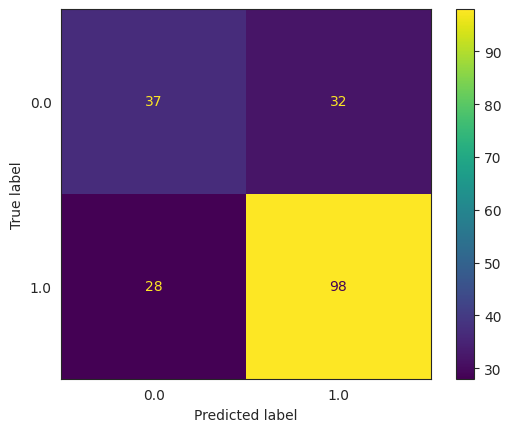

In [163]:
ConfusionMatrixDisplay.from_predictions(y_val_selected_features, y_pred)
plt.show()

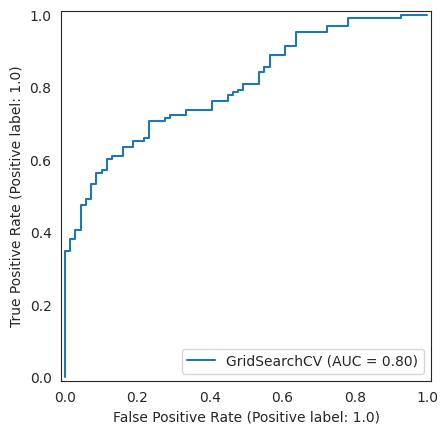

In [164]:
RocCurveDisplay.from_estimator(cat_boost_selected_features_grid_search, X_val_selected_features, y_val)
plt.show()

This has become a bit worse. So reducing noise by removing unimportant features is doesn't help. Let's see the importances anyway:

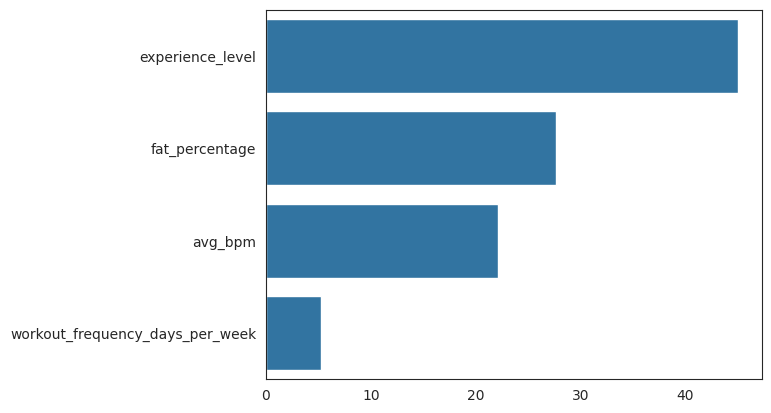

936:	learn: 0.3453520	total: 7.28s	remaining: 490ms
937:	learn: 0.3452347	total: 7.29s	remaining: 482ms
938:	learn: 0.3449877	total: 7.29s	remaining: 474ms
939:	learn: 0.3449101	total: 7.29s	remaining: 465ms
940:	learn: 0.3447301	total: 7.29s	remaining: 457ms
941:	learn: 0.3446238	total: 7.29s	remaining: 449ms
942:	learn: 0.3444017	total: 7.3s	remaining: 441ms
943:	learn: 0.3443727	total: 7.3s	remaining: 433ms
944:	learn: 0.3442817	total: 7.3s	remaining: 425ms
945:	learn: 0.3441939	total: 7.3s	remaining: 417ms
946:	learn: 0.3440494	total: 7.3s	remaining: 409ms
947:	learn: 0.3438656	total: 7.3s	remaining: 401ms
948:	learn: 0.3437568	total: 7.31s	remaining: 393ms
949:	learn: 0.3437528	total: 7.31s	remaining: 385ms
950:	learn: 0.3436492	total: 7.31s	remaining: 377ms
951:	learn: 0.3435179	total: 7.32s	remaining: 369ms
952:	learn: 0.3434093	total: 7.32s	remaining: 361ms
953:	learn: 0.3432764	total: 7.33s	remaining: 353ms
954:	learn: 0.3430468	total: 7.33s	remaining: 345ms
955:	learn: 0.3429

In [165]:
cat_boost_feature_importances = pd.Series(cat_boost_selected_features_grid_search.best_estimator_.feature_importances_, index=X_train_selected_features.columns)

sns.barplot(cat_boost_feature_importances.sort_values(ascending=False), orient="h")
plt.show()

No surprises here.

## **3. Conclusion**
When it comes to burning calories, the most important thing is the duration of the workout. That became apparent right away with the very high correlation levels. So if you spend more time, you burn more calories. 

The next most important feature is the experience level. The more experience you have, the more calories you burn. But we also found out, that these two features are connected and experts always train for more than 1.5 hours and other people always train for less than 1.5 hours. 

Another important feature is the fat percentage, where we can see a clear negative correlation. Again, there is a strong link between this and the experience level, because the most experienced people have less than 20% fat and as we found out earlier, they all burn more than 800 calories.

The average BPM also played a big role in the models, although when put on a scatterplot, the pattern isn't so clear.